## Configuración inicial

A continuación se importan las librerías necesarias para el funcionamiento del notebook. 

In [1]:
#plots and data
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

#metrics and transformations
from sklearn.preprocessing import MinMaxScaler,StandardScaler
from sklearn.metrics import mean_squared_error
from sklearn import metrics

#Model 
from sklearn.neural_network import ELMRegressor
sns.set()

In [3]:
def plot_predict_test(df_test_y,testPredict,lag):
        ### Resultado predicción datos de entrenamiento
    print(testPredict.flatten())
    fig, ax = plt.subplots(figsize=[15,8])
    sns.lineplot(df_test_y.flatten(),label="real")
    sns.lineplot(testPredict.flatten(),label="predicción")
    plt.title("Comparación valor real y predicción")
    plt.ylabel("value")

In [4]:
def createLagFeature(name_features,lag,df):
    for name_feature in name_features:
        for i in range(1,lag+1):
            df[name_feature+"lag"+str(i)]=df[name_feature].shift(i)
    return df

In [5]:
#function to measure the performance
def timeseries_evaluation_metrics_func(y_true, y_pred,flag):
    def mean_absolute_percentage_error(y_true, y_pred): 
        epsilon=0.1e-5
        y_true, y_pred = np.array(y_true), np.array(y_pred)
        return np.mean(np.abs((y_true - y_pred) / y_true)) * 100
    
    if flag : print(f'R2 is : {metrics.r2_score(y_true, y_pred)}',end='\n\n')
    else:
        print('Evaluation metric results:')
        print(f'MSE is : {metrics.mean_squared_error(y_true, y_pred)}')
        print(f'MAE is : {metrics.mean_absolute_error(y_true, y_pred)}')
        print(f'RMSE is : {np.sqrt(metrics.mean_squared_error(y_true, y_pred))}')
        print(f'MAPE is : {mean_absolute_percentage_error(y_true, y_pred)}')
        
    return {"MSE":metrics.mean_squared_error(y_true, y_pred),
           "MAE":metrics.mean_absolute_error(y_true, y_pred),
           "RMSE":np.sqrt(metrics.mean_squared_error(y_true, y_pred)),
           "MAPE":mean_absolute_percentage_error(y_true, y_pred)}

---

## Cargar y preparar los datos.

In [2]:
df = pd.read_csv("../../Datasets/Datos_durante_pandemia/data_durante_vol_in_ic.csv")

df['Fecha'] = pd.to_datetime(df['Fecha'])
df = df.sort_values('Fecha', ascending=True)
df = df.rename(columns = {'Vol. Futuros': 'VolFuturos'})
df

,Fecha,VolFuturos,VIX,EMV-ID,EPU,PI,MHI,FNI,SI
0,2020-01-01,1.289946,12.548403,1.89,186.06,0.00,0.00,0.00,0.00
1,2020-01-02,0.735046,12.470000,2.84,139.13,0.00,0.00,0.00,0.00
2,2020-01-03,0.591834,14.020000,1.33,108.10,0.00,0.00,0.00,0.00
3,2020-01-04,1.367154,14.646666,0.00,212.82,0.00,0.00,0.00,0.00
4,2020-01-05,1.505321,14.311970,0.86,173.76,0.00,0.00,0.00,0.00
...,...,...,...,...,...,...,...,...,...
913,2022-07-02,0.778572,25.922916,11.11,130.95,4.66,25.71,0.19,-3.56
914,2022-07-03,0.819483,26.641413,23.06,135.95,0.42,7.76,0.00,-3.67
915,2022-07-04,0.843804,27.530000,15.98,309.83,0.54,31.37,0.27,-5.85
916,2022-07-05,0.850985,27.540000,18.90,116.59,0.48,38.21,0.12,-4.97


---

## Desarrollo del modelo

In [7]:
#objects to scale the data 
sc=StandardScaler()
sc2=StandardScaler()

In [8]:
df_stats=df

In [9]:
#
len_data=df_stats.shape[0]

#get target
df_label=df_stats["VolFuturos"].values.reshape(len_data,1)
#get attributes
df_data=df_stats.drop(columns=["Fecha"])

#apply scale
#df_label=sc.fit_transform(df_label)
#df_data_normalize=sc2.fit_transform(df_data)


In [10]:
def Model(df_data,df_label,lag,estimators):
    delete_columns=list(df_data.columns)
    df_data_lags=createLagFeature(df_data.columns,lag,df_data) if lag>0 else df_data
    
    df_data_lags.drop(columns=delete_columns,inplace=True)
    df_data_lags=df_data_lags[lag:]
    df_label=df_label[lag:]

    #transform data
    df_data_lags=sc2.fit_transform(df_data_lags)
    
    #split data
    #last index of the train data
    seventy_percent=int(len_data*0.7)

    #split the data normalize
    
    df_train=df_data_lags[:seventy_percent]
    df_test=df_data_lags[seventy_percent:]

    #split labels
    
    df_train_y=df_label[:seventy_percent]
    df_test_y=df_label[seventy_percent:]
    #split labels normalize
    
    df_label_normalize=sc.fit_transform(df_label)
    df_train_y_normalize=df_label_normalize[:seventy_percent]
    df_test_y_normalize=df_label_normalize[seventy_percent:]
    


    #make model
    model=ELMRegressor(hidden_layer_sizes=(estimators,), activation='logistic', solver='adam')
    #fit the model with the train data
    history=model.fit(df_train,df_train_y_normalize)
   
    # make predictions
    trainPredict = model.predict(df_train)
    trainPredict = np.reshape(trainPredict,(len(trainPredict),1))
    # invert transformation
    trainPredict = sc.inverse_transform(trainPredict)
    
    trainY = df_train_y
    
    # make predictions
    testPredict = model.predict(df_test)
    # invert transformation
    testPredict = np.reshape(testPredict,(len(testPredict),1))
    testPredict = sc.inverse_transform(testPredict)
    testY = df_test_y
    print("len test: ",testY.shape)
    print("len PREDICT: ",testPredict.shape)

    plot_predict_test(df_train_y,trainPredict,lag)
    plot_predict_test(df_test_y,testPredict,lag)
    return [{"Fecha":df_stats.Fecha[lag:][:seventy_percent],"typeELM":["train"]*len(trainPredict.flatten()),"ELM" :trainPredict.flatten()}
            ,{"Fecha":df_stats.Fecha[lag:][seventy_percent:],"typeELM":["test"]*len(testPredict.flatten()),"ELM":testPredict.flatten()}]
    
    return {"train":timeseries_evaluation_metrics_func(trainY.flatten()+1, trainPredict.flatten()+1,False),
           "test":timeseries_evaluation_metrics_func(testY.flatten()+1, testPredict.flatten()+1,False)}

## Resultados

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.27479635 1.33594743 1.26249058 1.19342717 1.1874818  1.66459425
 1.21256925 1.6127105  1.17607545 1.52340971 1.20910654 1.23112389
 1.21509184 1.19574    1.09311222 1.10593536 0.96817889 0.92876848
 0.99556163 0.8831672  1.27579121 1.36998145 1.51071463 1.36054193
 1.36253483 1.42076852 1.6929753  1.21941597 1.58387444 1.25473007
 1.79586038 1.47712638 1.33874865 1.33424968 1.05383736 0.96976292
 1.04306017 1.08597794 1.04162194 0.95848984 0.95464297 1.83863174
 1.87944908 1.58204073 1.72368122 1.48772855 1.23396469 1.18374376
 1.67895691 2.08455078 1.67794033 2.1772807  1.73749087 1.58189011
 1.92414957 1.75733919 1.87495246 1.63778796 2.07512524 2.68063404
 2.71834079 2.36483685 2.96097652 2.45048435 2.22577293 1.73442528
 2.18266564 2.50594411 2.65055485 2.74966266 2.02378146 1.79404744
 1.67713901 2.06217042 2.7675935  2.87865504 2.94112864 2.34892787
 2.24162839 1.9163132  2.15430719 2.72801118 2.54407145 2.83783987
 3.05701432 2.45631

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.20121929 1.28298375 1.22748571 1.12719196 1.11188436 1.61308884
 1.1525792  1.52617653 1.09064866 1.46506993 1.15657919 1.14523962
 1.1407642  1.14069896 1.02373099 1.02196456 0.8953275  0.87005729
 0.94011716 0.81402963 1.22570442 1.32180366 1.45579284 1.29494063
 1.31116946 1.36212887 1.64671189 1.15072345 1.519768   1.20725322
 1.75786801 1.42629711 1.26510239 1.26310751 0.99585323 0.90931427
 0.98957542 1.04396289 1.00033435 0.90372647 0.91877788 1.79080413
 1.8479514  1.51843635 1.64951499 1.45000399 1.16604512 1.10372693
 1.6518674  2.07097122 1.61862232 2.14563934 1.70843056 1.53414812
 1.95886658 1.69252225 1.86512679 1.54942437 2.07454438 2.62949347
 2.75098102 2.32936135 3.1021895  2.44644524 2.31727436 1.70784892
 2.20357339 2.53407485 2.62613328 2.79084628 2.10504507 1.84713687
 1.66075097 2.17870082 2.8525209  3.08556299 3.02881245 2.24337268
 2.22284868 2.04190606 2.10476089 2.71716297 2.59347293 2.90645603
 3.15873178 2.34111

Evaluation metric results:
MSE is : 1.4376222207219944
MAE is : 0.8602063937559274
RMSE is : 1.1990088493092927
MAPE is : 41.17735114111203
Evaluation metric results:
MSE is : 1.252822461210926
MAE is : 0.8801001390090751
RMSE is : 1.1192955200530939
MAPE is : 43.84407140941529


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.18721789 1.28847897 1.22108594 1.0895666  1.09794305 1.62216207
 1.14333268 1.5104707  1.09845822 1.48104426 1.15078058 1.12479088
 1.15122898 1.16047138 1.03663385 1.03847065 0.92337806 0.8950746
 0.95466202 0.83991894 1.25203319 1.33206255 1.44164379 1.28099426
 1.29185849 1.36550531 1.64276456 1.12550822 1.50607664 1.18492133
 1.73142055 1.38145857 1.22341903 1.25765708 1.0110044  0.92741573
 0.9992166  1.04478201 1.00456484 0.90033861 0.92001363 1.80501678
 1.82817552 1.45208394 1.6405453  1.43529622 1.15602135 1.10529607
 1.67961547 2.06518346 1.5380772  2.12124656 1.63492108 1.45559101
 1.8689323  1.63346266 1.82520583 1.51857674 2.05587437 2.72771712
 2.75424286 2.28268044 3.21285565 2.38603951 2.29029292 1.67295697
 2.19187729 2.45456034 2.6170745  2.8522057  2.00000808 1.73263201
 1.57960667 2.08036315 2.86559723 3.08801787 2.99520209 2.12053411
 2.11767314 1.80075288 2.04517214 2.71034033 2.43531492 2.80962987
 3.19356327 2.201455

Evaluation metric results:
MSE is : 1.4429451008013816
MAE is : 0.8599053845600427
RMSE is : 1.2012264985427943
MAPE is : 40.9975325391914
Evaluation metric results:
MSE is : 1.2450770927229025
MAE is : 0.8717408014706065
RMSE is : 1.1158302257614743
MAPE is : 42.8642917337622


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.24621516 1.34250796 1.27913332 1.16903664 1.17157196 1.68769096
 1.1841889  1.56711786 1.14599278 1.53792075 1.19599519 1.1895242
 1.20833971 1.20636197 1.07937421 1.08698699 0.96849213 0.94043598
 1.00392136 0.88182581 1.30134216 1.35386958 1.4761175  1.32910597
 1.36126138 1.43980479 1.69505675 1.18344508 1.57011538 1.23818562
 1.80932605 1.46369513 1.31927966 1.33574563 1.07271044 0.9871796
 1.0592433  1.11435072 1.06289357 0.95952414 1.00353513 1.87117502
 1.87291302 1.50025874 1.70441221 1.49707363 1.2221609  1.15289925
 1.73634783 2.11470891 1.59181181 2.1658749  1.70437914 1.52773596
 1.93112295 1.64176048 1.84830896 1.55371717 2.10108523 2.78980947
 2.79071069 2.3162721  3.19715032 2.36376081 2.19591618 1.62236559
 2.16616371 2.51118012 2.55119156 2.70001646 2.05023915 1.77788837
 1.60394192 2.12347555 3.00967121 3.21338996 3.04905371 2.23268891
 2.1708817  2.03856175 2.19891476 2.83493802 2.6023538  2.96317429
 3.26195082 2.2620067

Evaluation metric results:
MSE is : 1.428949494605007
MAE is : 0.864448359174629
RMSE is : 1.1953867552407493
MAPE is : 42.095624548294595
Evaluation metric results:
MSE is : 1.2653886471252527
MAE is : 0.8903752165283784
RMSE is : 1.1248949493731637
MAPE is : 44.90085397039525


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.19969056 1.28478942 1.2289296  1.12289412 1.1225757  1.59997373
 1.16405507 1.53210536 1.12244079 1.47321591 1.1637379  1.15960071
 1.16380997 1.15793073 1.04986395 1.0563736  0.93065387 0.89876596
 0.95360191 0.84380072 1.24152841 1.32091215 1.45025822 1.31080356
 1.32461754 1.36769939 1.63381801 1.16450798 1.50955092 1.18852714
 1.72419746 1.40408371 1.2635075  1.26735816 1.00885769 0.93142651
 1.0051853  1.04787993 1.00918812 0.9154193  0.9368683  1.76502296
 1.81471202 1.51170356 1.65815631 1.44125213 1.17696027 1.13240081
 1.6336503  2.03200025 1.58789521 2.13466862 1.64464398 1.47711877
 1.87413267 1.59099094 1.82197613 1.52923575 2.02997647 2.66263281
 2.72175112 2.31407073 3.25410252 2.42402435 2.33597325 1.64929984
 2.11643285 2.4525825  2.67999337 2.86214962 2.06586582 1.71427122
 1.46546724 2.10863501 2.89618344 3.0767485  3.02659432 2.32692075
 2.20358948 1.78667346 1.9572147  2.612406   2.45968488 2.86025393
 3.28231383 2.32560

Evaluation metric results:
MSE is : 1.4465213750706596
MAE is : 0.8592324518608989
RMSE is : 1.202714170146282
MAPE is : 40.768247548783506
Evaluation metric results:
MSE is : 1.248200889697081
MAE is : 0.8723740764784391
RMSE is : 1.1172291124460914
MAPE is : 42.884353294066585


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.22948391 1.3201447  1.2497101  1.15053612 1.15047484 1.64029468
 1.17156564 1.56181206 1.1444447  1.51167188 1.18004045 1.1819387
 1.19138767 1.18316895 1.06619886 1.07861333 0.96227971 0.91730858
 0.9805848  0.8629876  1.27033142 1.3361469  1.45791089 1.3142863
 1.32036726 1.40848593 1.65948555 1.17114586 1.55740617 1.20702789
 1.74382522 1.42659126 1.29559368 1.30257405 1.03486491 0.96204929
 1.0245115  1.07692541 1.03542451 0.93792531 0.95717647 1.81739969
 1.83145286 1.5114893  1.70271767 1.45496559 1.187548   1.14326327
 1.69069277 2.05851687 1.59169055 2.1793271  1.65822114 1.52256002
 1.91257848 1.61798464 1.81720384 1.54194453 2.06156719 2.68925145
 2.72131382 2.31672092 3.32727376 2.36797544 2.3365868  1.66024559
 2.14169703 2.5088216  2.6817302  2.78972459 2.00209572 1.78057884
 1.60394477 1.98720051 2.82228615 3.19881851 3.09681083 2.32714708
 2.27670809 1.91136343 2.01521727 2.63957371 2.43794696 2.895049
 3.31550785 2.23553049 

Evaluation metric results:
MSE is : 1.4417262654030785
MAE is : 0.8578033963016559
RMSE is : 1.2007190618138277
MAPE is : 40.631641504457036
Evaluation metric results:
MSE is : 1.2560264930115208
MAE is : 0.8769580935799505
RMSE is : 1.1207258777290372
MAPE is : 43.32053633263578


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.19007578 1.29689049 1.21691069 1.11124972 1.10576668 1.61199841
 1.12533622 1.50797027 1.0959555  1.4765818  1.14379276 1.13719876
 1.14867581 1.14301452 1.02044232 1.0292441  0.91731142 0.87117158
 0.93911537 0.81312577 1.22971077 1.29265971 1.40807434 1.26486381
 1.26633846 1.36045231 1.61435353 1.1284273  1.49734159 1.1677375
 1.71778038 1.38612783 1.23029964 1.25811931 0.99955555 0.91966069
 0.98622002 1.03711043 0.98902298 0.90138359 0.91045818 1.7994465
 1.79508296 1.44317444 1.63680668 1.41644263 1.15290476 1.09568404
 1.64222229 2.03532698 1.54539372 2.12047792 1.62064656 1.44028129
 1.83663975 1.57091395 1.77192956 1.49618503 2.04723623 2.70243683
 2.75164543 2.30704322 3.32422209 2.38708227 2.2909508  1.62481296
 2.11030432 2.50079034 2.74363975 2.88384364 2.05595652 1.76088958
 1.58338224 2.0967949  2.99131253 3.16405141 3.11786534 2.37070423
 2.34641227 1.95399463 2.08643839 2.84189006 2.57138118 2.98496063
 3.40316336 2.3465225

Evaluation metric results:
MSE is : 1.4443155222779598
MAE is : 0.8617193624087024
RMSE is : 1.2017967890945456
MAPE is : 41.261137553019786
Evaluation metric results:
MSE is : 1.2523407289495743
MAE is : 0.8724241503513043
RMSE is : 1.1190803049600928
MAPE is : 42.806930302728595


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.2770555  1.38142037 1.2920044  1.18681621 1.1902626  1.69699677
 1.21559913 1.59826657 1.18934869 1.56362356 1.2264848  1.22307841
 1.24061708 1.23955409 1.11763788 1.12754576 1.01481668 0.96534635
 1.03677924 0.91230018 1.32934358 1.39140477 1.51424733 1.35697057
 1.35574666 1.44416099 1.70173515 1.20413879 1.58049893 1.25302112
 1.77860057 1.44743686 1.30438578 1.33356314 1.08803489 1.01044943
 1.07595232 1.12436146 1.08347811 0.98276766 1.00066443 1.87499548
 1.87185888 1.52375596 1.71738857 1.50807689 1.24090824 1.17336335
 1.73964233 2.09766426 1.60498871 2.17756127 1.69896646 1.50760747
 1.90203003 1.65094086 1.84117447 1.54218551 2.06745275 2.68916559
 2.76125369 2.29924992 3.35620329 2.39133794 2.34359414 1.695387
 2.15040259 2.4703612  2.7323097  2.90030706 2.0168601  1.75706553
 1.54972256 2.1494134  2.81717789 3.15339403 3.07191507 2.30409561
 2.24906436 1.85662602 1.95529868 2.69899905 2.45938577 2.91650312
 3.39567768 2.2885069

Evaluation metric results:
MSE is : 1.4462447261530773
MAE is : 0.870914301997051
RMSE is : 1.2025991543956271
MAPE is : 42.37577981477765
Evaluation metric results:
MSE is : 1.2535179315418976
MAE is : 0.8817472072333035
RMSE is : 1.119606150189386
MAPE is : 44.27109190120252


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.25966131 1.3686168  1.28648983 1.18004826 1.18064261 1.71809622
 1.23453441 1.61691053 1.18620002 1.56978076 1.22684278 1.21333372
 1.232809   1.23955925 1.11608317 1.12094387 0.99673196 0.94114395
 1.02273093 0.89628721 1.33148049 1.39658617 1.50298162 1.33415029
 1.3462253  1.48309814 1.7366758  1.21746519 1.57063956 1.22399115
 1.7959603  1.48776108 1.32745229 1.3506722  1.08761458 0.99828498
 1.05769079 1.1226008  1.07247288 0.96256679 0.98552522 1.90413398
 1.91587552 1.54484895 1.71903266 1.49736852 1.23557896 1.17429883
 1.75313565 2.13535273 1.61022768 2.17364359 1.68220426 1.51380742
 1.92114265 1.62062279 1.81398295 1.60367231 2.14267758 2.80179142
 2.8467978  2.39855831 3.4126365  2.44054704 2.34865056 1.66649038
 2.1683061  2.59461408 2.78297065 2.84687588 2.07893049 1.85343042
 1.45048536 1.8544141  2.86052767 3.25494347 3.20025857 2.36267683
 2.25770274 1.86599178 1.92565743 2.72142259 2.465187   2.98490706
 3.48907929 2.30484

Evaluation metric results:
MSE is : 1.4444066465536212
MAE is : 0.8688931963379144
RMSE is : 1.2018347001786982
MAPE is : 41.93950573930145
Evaluation metric results:
MSE is : 1.2627666433199656
MAE is : 0.8861066678178182
RMSE is : 1.1237289011678775
MAPE is : 44.47132224759743


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.24251044 1.35753049 1.30602151 1.18975254 1.16619522 1.66463838
 1.2544583  1.54667999 1.17293799 1.5226657  1.24248742 1.19432
 1.20312429 1.22733663 1.11786308 1.10507604 1.00026782 0.95704727
 1.02710453 0.91242503 1.3032395  1.39609426 1.49252146 1.34133955
 1.33989474 1.45752247 1.7162942  1.23555535 1.53131591 1.25806341
 1.76321356 1.49200382 1.31099827 1.30985029 1.08851689 1.01554856
 1.07492819 1.12955749 1.09483475 0.98576412 0.99469967 1.84574706
 1.90235255 1.51783647 1.62642059 1.47675225 1.23197553 1.16151434
 1.70439511 2.11435814 1.62478557 2.08822614 1.69754357 1.53771409
 1.89833155 1.6639059  1.84676839 1.66366003 2.09792542 2.73671452
 2.86682911 2.39984952 3.4200006  2.49719333 2.37936627 1.76320272
 2.24253444 2.64142511 2.83773559 2.95054441 2.20582335 2.00078311
 1.71645368 2.16737076 3.03521764 3.47241514 3.41504547 2.61478676
 2.40630669 2.00669067 2.11800318 2.82075828 2.65652252 3.11827181
 3.69185868 2.53281133

Evaluation metric results:
MSE is : 1.4510390922099188
MAE is : 0.879454731060331
RMSE is : 1.2045908401652068
MAPE is : 43.260022720276645
Evaluation metric results:
MSE is : 1.2497542553918382
MAE is : 0.8827028060570223
RMSE is : 1.1179240830180903
MAPE is : 44.70167180206378


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.18977392 1.30000026 1.21517328 1.11337493 1.10821874 1.59661654
 1.12160974 1.48360371 1.09873204 1.46464529 1.14361121 1.133899
 1.15151906 1.14858738 1.02680104 1.03535167 0.93446657 0.88530226
 0.95558719 0.83043311 1.22926878 1.28701421 1.394454   1.26126539
 1.25785831 1.3716865  1.58839452 1.12922956 1.48289631 1.17255483
 1.68272366 1.3754628  1.21963584 1.25444377 1.00764487 0.93480574
 0.98356853 1.04673974 0.99308573 0.91490412 0.91593861 1.76754326
 1.7514893  1.40661194 1.61358729 1.39769425 1.15049605 1.09583715
 1.64034281 1.98260865 1.49836563 2.06389295 1.57885584 1.44307071
 1.78588311 1.562799   1.78614786 1.54847487 2.03273084 2.70542526
 2.73269603 2.2517596  3.33162133 2.32171023 2.24667404 1.64044977
 2.13050796 2.49004505 2.70345183 2.91471487 2.04865032 1.76430452
 1.62276418 2.10096247 2.95494489 3.19201179 3.20274819 2.37555496
 2.35588018 1.93707175 2.04208255 2.8605439  2.54934571 3.05739727
 3.60105963 2.4028179

<ipython-input-3-72e029a2b199>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=[15,8])


Evaluation metric results:
MSE is : 1.4502832789891722
MAE is : 0.8655002151888764
RMSE is : 1.2042770773327758
MAPE is : 41.65117464054956
Evaluation metric results:
MSE is : 1.2367714255423705
MAE is : 0.8641204880745529
RMSE is : 1.112102254984842
MAPE is : 42.24804474513038


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.43360749 1.53495885 1.45208868 1.35897165 1.36122614 1.84782967
 1.40554223 1.78346918 1.3770146  1.71833477 1.39346278 1.39847275
 1.40855494 1.40323333 1.29528973 1.30710002 1.18318618 1.12342807
 1.19372346 1.08184829 1.48798576 1.55962656 1.68337293 1.54211606
 1.53853398 1.64375327 1.87295784 1.41033592 1.73708928 1.4049255
 1.93546408 1.65270612 1.50420073 1.5042114  1.24465339 1.17443567
 1.22202536 1.290776   1.23441188 1.1483429  1.15818181 2.00685953
 2.04446985 1.72643549 1.89064831 1.64910697 1.40137547 1.35768046
 1.87985108 2.24217874 1.79603621 2.35162036 1.85741415 1.7382419
 2.10292115 1.82065585 2.02977929 1.78337579 2.27329913 2.93086944
 2.98772072 2.56250496 3.66883659 2.67910095 2.61340978 1.85587159
 2.27663343 2.70550137 3.00025434 3.17935997 2.2551661  1.94875587
 1.55534069 2.01671865 3.09477608 3.41448768 3.39917275 2.60046991
 2.45502313 1.94685289 1.91266429 2.75165346 2.56329991 3.13792049
 3.71898407 2.5186421

Evaluation metric results:
MSE is : 1.4602208194408846
MAE is : 0.8934992890609931
RMSE is : 1.2083959696394575
MAPE is : 44.59546925948318
Evaluation metric results:
MSE is : 1.2952439487051082
MAE is : 0.9160102400396863
RMSE is : 1.138087847534235
MAPE is : 48.03015501241747


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.17104158 1.26791036 1.18436671 1.09030339 1.08240562 1.60466256
 1.16869804 1.54048124 1.10903697 1.45589394 1.13787617 1.12940734
 1.13086584 1.13613895 1.02881928 1.03049577 0.89260537 0.83008835
 0.91905601 0.80422305 1.22658742 1.32183766 1.46811054 1.29396856
 1.28094583 1.40199012 1.64795947 1.16639548 1.5003381  1.18884182
 1.73413831 1.44721755 1.27145887 1.26721975 1.00761467 0.9243718
 0.97590008 1.06318723 1.00109366 0.89449912 0.89700759 1.79240489
 1.87598495 1.5364738  1.65269189 1.42674865 1.18519949 1.10486591
 1.68409952 2.0860462  1.61453214 2.1460794  1.67126182 1.5690992
 1.95468125 1.73749943 1.99222153 1.77933947 2.28690517 2.89164687
 2.98395579 2.54618922 3.71167758 2.66744466 2.59776426 1.9239768
 2.42334047 2.84881321 3.1279394  3.27761799 2.34222474 2.15667572
 1.95899955 2.5745653  3.36780504 3.57850648 3.6588218  2.85395673
 2.69028702 2.28155417 2.21966094 3.06669323 2.77380212 3.32425523
 3.93043262 2.677936  

Evaluation metric results:
MSE is : 1.4560679469615574
MAE is : 0.8769900001207481
RMSE is : 1.2066764052394319
MAPE is : 42.7628326179745
Evaluation metric results:
MSE is : 1.253644626130515
MAE is : 0.8811119412875984
RMSE is : 1.119662728740452
MAPE is : 44.36564347819108


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (271, 1)
len PREDICT:  (271, 1)
[ 1.29116248  1.23673554  1.19202935  1.54922569  1.10561025  1.47985987
  1.21363399  1.58701044  1.28583225  1.22426727  1.2388854   1.19083349
  1.07673415  1.09439889  1.04019382  1.03489404  1.06102891  0.90610949
  1.23166629  1.28345025  1.34691176  1.31302113  1.39999405  1.43368247
  1.59925846  1.13985555  1.61291875  1.34143566  1.64949183  1.438626
  1.44791883  1.47560841  1.19816139  1.0916754   1.12245418  1.10480671
  1.0578261   1.06048325  1.06348802  1.80909112  1.64377922  1.38448091
  1.81919965  1.6301195   1.21360186  1.1881032   1.69695872  2.02454409
  1.52784267  2.16536174  1.76286617  1.42379637  1.80483041  1.58091863
  1.81391442  1.89219822  2.39241019  3.00080187  3.16852644  2.99864301
  3.31414883  2.4622416   2.26425281  1.629094    2.07453125  2.4975666
  2.58434653  2.44511573  2.13129184  2.24657183  1.28983409  1.96455694
  2.82728056  3.11457304  3.07376295  2.02617508  2.0401056   1.93056484
  2.1252487

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (271, 1)
len PREDICT:  (271, 1)
[ 1.29785188  1.2577025   1.16752557  1.54658546  1.06966694  1.46705743
  1.19519292  1.63523555  1.3259306   1.24113036  1.2253248   1.18474131
  1.05210711  1.06059089  1.01452939  1.00184093  1.04657915  0.83567369
  1.19349746  1.27539356  1.37374194  1.30784727  1.39537163  1.4352156
  1.57115646  1.07577159  1.59294419  1.32893565  1.62897589  1.42337672
  1.39411066  1.37369159  1.12776843  1.03325749  1.04431595  1.05673091
  0.99869031  0.99509181  1.0077075   1.80668701  1.68860525  1.31098095
  1.79444941  1.62939232  1.21910644  1.12521987  1.69094837  2.08769854
  1.56964884  2.14624553  1.72625989  1.43273347  1.74908794  1.50402451
  1.98793524  1.95644606  2.4786652   3.12416924  3.37961044  3.09740769
  3.30292328  2.33984239  2.09218996  1.68425238  2.15936503  2.65896994
  2.66848849  2.60532186  2.42863702  2.23085547  1.42945119  1.97341518
  2.97366039  3.72068635  3.3127515   1.86914053  1.86216946  1.80384646
  1.96574

Evaluation metric results:
MSE is : 1.3347274631363906
MAE is : 0.8404871103680378
RMSE is : 1.1553040565740218
MAPE is : 40.347365681814495
Evaluation metric results:
MSE is : 1.3243902815758113
MAE is : 0.8961161782183541
RMSE is : 1.1508215680876908
MAPE is : 44.34378544501802


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (271, 1)
len PREDICT:  (271, 1)
[ 1.22635189  1.19640885  1.10037809  1.45174143  0.97206917  1.37610787
  1.09777494  1.54585942  1.22872186  1.17044004  1.14004408  1.10675354
  0.98984244  1.00326289  0.96600184  0.96468481  1.01024046  0.79750867
  1.14263156  1.1934396   1.28203549  1.24290095  1.33970877  1.39615836
  1.51518605  1.0319454   1.56297227  1.26432411  1.56904935  1.36863263
  1.37766501  1.357015    1.11042905  1.03818296  1.03940068  1.03416753
  0.9868839   0.98866711  1.00455113  1.74206765  1.5307084   1.23226732
  1.75579875  1.59310336  1.16568957  1.12335385  1.63513792  1.95542926
  1.46040452  2.12043139  1.72350646  1.35422625  1.63668161  1.39824512
  1.7856483   1.78583268  2.3820403   3.0282715   3.26026146  3.01690786
  3.38746386  2.41140936  2.15130746  1.70926603  2.18235737  2.471984
  2.56388205  2.59574181  2.40930143  2.26409511  1.56591273  1.91081085
  3.06704309  3.81217323  3.46610803  1.83526565  1.98166714  2.07353653
  2.221124

Evaluation metric results:
MSE is : 1.322549359507547
MAE is : 0.8406339208227152
RMSE is : 1.1500214604552157
MAPE is : 40.98588992595023
Evaluation metric results:
MSE is : 1.3374461152142982
MAE is : 0.9015848605386233
RMSE is : 1.1564800539630151
MAPE is : 44.62214658242701


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (271, 1)
len PREDICT:  (271, 1)
[ 1.30293254  1.27351482  1.1793126   1.49186052  1.03410587  1.43494322
  1.17540892  1.59241477  1.2933526   1.24480225  1.2192822   1.16872738
  1.06852209  1.09388536  1.05869527  1.05173638  1.09021814  0.89345521
  1.21676363  1.24622404  1.31772536  1.30142564  1.3828754   1.42061211
  1.52624141  1.06669447  1.56894456  1.2785988   1.59352245  1.42252808
  1.42674677  1.39639735  1.14702844  1.09107745  1.10578076  1.11482152
  1.06812716  1.06664118  1.08709539  1.76065429  1.5608793   1.25065193
  1.79493973  1.56743334  1.18395395  1.18685333  1.64277733  1.93226215
  1.46930124  2.11009979  1.66432369  1.29246108  1.67800403  1.40511708
  1.81644615  1.82750548  2.41940499  3.05893236  3.16918621  2.96891938
  3.40109316  2.27356623  2.00633781  1.58638514  2.02528272  2.40397369
  2.38606902  2.28864153  2.1405179   2.12845725  1.29387907  1.78591843
  3.03112684  3.68233794  3.00551795  1.57756442  1.59600646  1.71236741
  2.0588

Evaluation metric results:
MSE is : 1.3228884131002512
MAE is : 0.8304814196566761
RMSE is : 1.1501688628632976
MAPE is : 39.44597271472936
Evaluation metric results:
MSE is : 1.3201729846899886
MAE is : 0.894547057356722
RMSE is : 1.1489878087647356
MAPE is : 44.166024627243104


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (271, 1)
len PREDICT:  (271, 1)
[ 1.23753395  1.22768907  1.13590885  1.41375131  0.99218476  1.37666181
  1.12440469  1.5143272   1.24473718  1.20138725  1.15679349  1.09827517
  1.01367025  1.04343462  1.00948981  1.00005944  1.0479265   0.85804766
  1.16162729  1.19991451  1.28870098  1.27116167  1.32100476  1.37751333
  1.4775786   1.05426332  1.56373278  1.27842942  1.5506148   1.38922526
  1.39247414  1.34187589  1.11317965  1.06381938  1.08727867  1.08351997
  1.03501468  1.0351017   1.0495151   1.70590139  1.54990061  1.23769906
  1.70802681  1.47061458  1.16518442  1.13143153  1.59498155  1.92250093
  1.50468993  2.05132999  1.5910042   1.34241554  1.63667495  1.42000572
  1.86353497  1.83307654  2.37376124  3.07767345  3.22756376  3.0449245
  3.31804475  2.11991291  1.92178978  1.58324355  1.93199512  2.28092231
  2.27146796  2.24700536  2.09007212  2.01006912  1.34034181  1.93718862
  2.99673083  3.7953622   3.35798431  1.64988424  1.56829725  1.56646024
  1.98875

Evaluation metric results:
MSE is : 1.3095474509255947
MAE is : 0.8247023876223932
RMSE is : 1.14435460016797
MAPE is : 38.8156648618313
Evaluation metric results:
MSE is : 1.327647396344774
MAE is : 0.8923065698514625
RMSE is : 1.1522358249702072
MAPE is : 43.73585346023978


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (271, 1)
len PREDICT:  (271, 1)
[ 1.18421960e+00  1.14079268e+00  1.03541037e+00  1.34670835e+00
  9.29727943e-01  1.30201381e+00  1.02492872e+00  1.44228787e+00
  1.16159370e+00  1.10494893e+00  1.06101952e+00  1.02820284e+00
  9.41741606e-01  9.57142119e-01  9.20809327e-01  9.14531025e-01
  9.54614445e-01  7.73568929e-01  1.09009798e+00  1.13722441e+00
  1.22422091e+00  1.19775829e+00  1.25231326e+00  1.31348143e+00
  1.44388803e+00  1.00658518e+00  1.47987819e+00  1.20576203e+00
  1.50122104e+00  1.33617571e+00  1.34328921e+00  1.27917226e+00
  1.06401677e+00  1.02205081e+00  1.02021395e+00  1.01635085e+00
  9.69583312e-01  9.67996446e-01  9.73445772e-01  1.65012452e+00
  1.49224445e+00  1.17036226e+00  1.62129093e+00  1.45335426e+00
  1.11946389e+00  1.06147781e+00  1.54393465e+00  1.88001965e+00
  1.44277704e+00  1.96907602e+00  1.59708522e+00  1.35900514e+00
  1.60067521e+00  1.45592219e+00  1.88907600e+00  1.87284981e+00
  2.42370747e+00  3.16602945e+00  3.35304677e+0

Evaluation metric results:
MSE is : 1.3082509749937237
MAE is : 0.8314117738033725
RMSE is : 1.143787993901721
MAPE is : 39.76295479159307
Evaluation metric results:
MSE is : 1.326998846176691
MAE is : 0.8949080207415552
RMSE is : 1.1519543594156372
MAPE is : 44.163990866467664


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (271, 1)
len PREDICT:  (271, 1)
[ 1.13066606  1.10794547  0.99155756  1.30311069  0.85487713  1.24696605
  0.96137894  1.41192555  1.11269233  1.06322002  1.01338763  0.97802416
  0.88534105  0.90655099  0.8787663   0.86559381  0.92263134  0.7183461
  1.04266883  1.08171483  1.1679255   1.13043337  1.18301215  1.26432317
  1.39034498  0.91153956  1.4156856   1.13396945  1.43339627  1.27744111
  1.28859835  1.2116088   0.98236387  0.95678195  0.96009889  0.96167922
  0.91541068  0.91600903  0.9139883   1.62541217  1.41432781  1.08231845
  1.55926698  1.36371713  1.00415283  1.00687989  1.50070726  1.81468372
  1.34927979  1.9120807   1.4874706   1.20824353  1.54590769  1.29194225
  1.75823278  1.84087545  2.39155658  3.09671937  3.32133243  3.07485799
  3.39422307  2.21164936  1.95178052  1.51531014  1.99359003  2.42007097
  2.45592374  2.3577891   2.26285633  2.26997717  1.43628139  1.78192539
  3.11060884  4.2226825   3.5441173   1.66924749  1.66476814  1.83690759
  2.04493

Evaluation metric results:
MSE is : 1.3123670563256697
MAE is : 0.8281369520115156
RMSE is : 1.145585900893368
MAPE is : 38.89545850236832
Evaluation metric results:
MSE is : 1.3390437228632293
MAE is : 0.8861949959580893
RMSE is : 1.1571705677484323
MAPE is : 42.451998754349646


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (271, 1)
len PREDICT:  (271, 1)
[ 1.25945893  1.23753231  1.11973729  1.43693493  1.00140651  1.39964291
  1.11982525  1.56661515  1.26186382  1.21493778  1.15641617  1.1299183
  1.03383847  1.04972584  1.0159629   1.00751316  1.05367699  0.84021874
  1.1748122   1.20903484  1.305133    1.27556222  1.36144856  1.41994031
  1.50638127  1.07627051  1.55366555  1.25438941  1.58187749  1.41319433
  1.40574773  1.3428621   1.13596703  1.08317512  1.07741066  1.08813253
  1.03204833  1.03329067  1.04957511  1.7302368   1.53641795  1.24061496
  1.72225043  1.53748415  1.21582761  1.15684812  1.61853558  1.92135096
  1.51725282  2.06847614  1.64029516  1.34909844  1.60976911  1.38375605
  1.8776861   1.85293558  2.44571073  3.09462488  3.23511666  3.0259022
  3.38876659  2.2317207   2.03261734  1.61919563  2.06458796  2.46069023
  2.49600173  2.4725425   2.32715574  2.21371107  1.48639867  1.82661362
  3.32667969  4.09723468  3.47261668  1.85922082  1.77467541  1.87156489
  2.158472

Evaluation metric results:
MSE is : 1.320734244031501
MAE is : 0.8414073782215312
RMSE is : 1.1492320235842286
MAPE is : 40.99414724536685
Evaluation metric results:
MSE is : 1.3263321518677973
MAE is : 0.8961644005126994
RMSE is : 1.1516649477464342
MAPE is : 44.537467888800904


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[ 1.22695914  1.20082293  1.09199954  1.4047448   0.98150227  1.35044718
  1.04777244  1.50565404  1.20728743  1.17264745  1.11255444  1.09548187
  1.0023597   1.00499823  0.96452334  0.97179838  1.01641828  0.81848644
  1.13921786  1.17626874  1.26523692  1.21733966  1.29403696  1.35883799
  1.4678765   1.02295478  1.50513457  1.22775397  1.55396322  1.3539826
  1.36974481  1.30985148  1.10020007  1.06775702  1.04886838  1.04892734
  0.99693926  1.00573536  1.01630562  1.7082286   1.5005208   1.1940597
  1.61996106  1.48993728  1.18275617  1.11225391  1.57498798  1.90915022
  1.44301401  1.96282229  1.59094619  1.39460179  1.63268311  1.43808332
  1.9014485   1.92703686  2.45250076  3.03620208  3.22423708  3.02095328
  3.42708793  2.35125331  2.19948398  1.64547006  2.0793913   2.47689726
  2.52563764  2.44765859  2.33735001  2.33450117  1.59767119  2.07431616
  3.24002297  3.86330445  3.58413221  1.91686711  1.94043186  1.96852568
  2.271023

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[ 1.29114668  1.21721841  1.13468305  1.51179899  1.12691187  1.45940772
  1.1599435   1.60125874  1.28584444  1.23919344  1.19408839  1.21473301
  1.09813442  1.07948117  1.01610755  1.02003765  1.03753938  0.86333073
  1.19813057  1.26851033  1.36580899  1.30521237  1.3946966   1.4457352
  1.57476016  1.1084315   1.52861167  1.25425783  1.62331625  1.40006922
  1.38362777  1.33687007  1.16399989  1.08462468  1.05417269  1.05219594
  1.01940669  1.00701469  1.02262215  1.74098616  1.61594823  1.35091197
  1.71702285  1.61673139  1.32520102  1.20589566  1.64872912  1.99293749
  1.51528231  2.01903219  1.68743906  1.48394961  1.68531486  1.45265082
  1.92326277  1.86535232  2.35164315  2.93744787  3.20499835  2.89564107
  3.44559723  2.45197888  2.35387965  1.78210635  2.24903959  2.53312766
  2.6410362   2.7085586   2.56400459  2.32948987  1.3318293   2.02690173
  2.94242806  3.78394533  3.62955131  2.1250654   2.16000058  1.98373477
  2.09191

Evaluation metric results:
MSE is : 1.3794954888844444
MAE is : 0.862333728993454
RMSE is : 1.174519258626458
MAPE is : 42.342066208543216
Evaluation metric results:
MSE is : 1.30537961022176
MAE is : 0.8930368079459766
RMSE is : 1.1425321046787964
MAPE is : 44.50187279386659


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[ 1.27088525  1.21364617  1.101246    1.43259411  0.98896913  1.30377429
  1.05931508  1.55757411  1.24839028  1.17764974  1.13219384  1.14761641
  1.03172479  1.02015221  1.02081254  1.02329361  1.06738171  0.85858709
  1.16409739  1.19340185  1.25676338  1.217806    1.30257382  1.42840288
  1.50006806  1.01187601  1.48407155  1.25053784  1.57303717  1.36168887
  1.3269367   1.27878314  1.13834625  1.08969159  1.05631096  1.07822657
  1.02306289  1.01668564  1.03512455  1.71700808  1.48834463  1.08621053
  1.5781589   1.52383811  1.22566031  1.12202433  1.62598326  1.90370956
  1.37121211  1.90504776  1.59903917  1.3501565   1.52104283  1.33981713
  1.75704757  1.73859135  2.24640304  2.82085293  2.98774742  2.67732445
  3.1437707   2.07928361  1.84607852  1.47473669  1.97635458  2.33296405
  2.23151305  2.15773424  2.19295269  2.18575953  1.46142918  1.91146326
  3.17504893  4.13583622  3.4156378   1.60667835  1.59272581  1.83183105
  2.1899

Evaluation metric results:
MSE is : 1.344671691093812
MAE is : 0.8426915516541114
RMSE is : 1.1595997978155272
MAPE is : 40.32730765182808
Evaluation metric results:
MSE is : 1.3090869542451005
MAE is : 0.8800855065492542
RMSE is : 1.1441533788112066
MAPE is : 42.57659976891766


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[ 1.25008266  1.1870083   1.07199863  1.4394185   1.03072262  1.39728066
  1.09195912  1.5517288   1.24051788  1.19004087  1.1310884   1.13200494
  1.0311649   1.03101521  0.98661914  0.9686305   1.01232263  0.81659089
  1.16274522  1.22474968  1.33108082  1.26646215  1.28589252  1.3687544
  1.49744599  1.04047502  1.50761047  1.19280002  1.54325763  1.34999298
  1.31136342  1.23916307  1.07826912  1.04563026  1.01389188  1.02776
  0.98887499  0.97596681  0.98750556  1.72570136  1.5836087   1.26313939
  1.65727969  1.4984185   1.20960414  1.11201367  1.61227763  1.9889371
  1.49945459  1.97090861  1.55833436  1.36384743  1.5523626   1.34031725
  1.90972081  1.86735191  2.33130082  2.95307603  3.22908691  2.91501971
  3.45224384  2.30037627  2.15249858  1.6804742   2.18603449  2.59549174
  2.6323057   2.62785698  2.50375595  2.27994589  1.45106438  2.03817272
  2.94952493  3.86366177  3.73826844  2.18484618  2.12431077  2.00028546
  2.0394297  

Evaluation metric results:
MSE is : 1.3802446993940236
MAE is : 0.8664367409365801
RMSE is : 1.1748381588091288
MAPE is : 42.87349975386283
Evaluation metric results:
MSE is : 1.3204029228216665
MAE is : 0.8886384345203666
RMSE is : 1.1490878655793326
MAPE is : 43.603382230886105


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[ 1.48716405  1.43463561  1.33241229  1.68057448  1.26635871  1.62543982
  1.35320053  1.80308396  1.47955585  1.44049648  1.39430377  1.39890825
  1.28099614  1.27624957  1.24250923  1.22801036  1.25397085  1.0540368
  1.38481521  1.4175325   1.50917262  1.46043942  1.52043851  1.59607755
  1.66504319  1.26398095  1.68072662  1.42248922  1.74928483  1.54542286
  1.53177977  1.49963836  1.32896318  1.26971616  1.21782804  1.24399697
  1.18552746  1.2152981   1.20839269  1.88282494  1.71411049  1.4434343
  1.88902211  1.74318873  1.45466785  1.33022393  1.80141353  2.07111672
  1.64937935  2.16102116  1.81309962  1.62805199  1.7793245   1.60401048
  2.03788661  1.99797946  2.47311538  3.09729785  3.28646648  3.00946855
  3.53016325  2.50952784  2.37245385  1.90378456  2.33592567  2.63207207
  2.65101175  2.78310785  2.58439142  2.38442629  1.32649061  1.73355295
  2.90475767  3.62734404  3.6811486   2.12307349  2.16132179  2.14842874
  2.066228

Evaluation metric results:
MSE is : 1.3881093121441395
MAE is : 0.8745881676242806
RMSE is : 1.1781805091513522
MAPE is : 43.78070261818667
Evaluation metric results:
MSE is : 1.3245218851856198
MAE is : 0.9148282432470277
RMSE is : 1.150878744779666
MAPE is : 46.98873176152179


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[1.29587063 1.64190058 1.09493068 1.61974292 1.27163763 1.65578528
 1.48009987 1.4679527  1.40417833 1.22519328 1.11855965 1.20247764
 1.08173047 1.08729904 1.14460751 0.98424197 1.28090111 1.23382524
 1.47468686 1.44104124 1.45347425 1.44269214 1.72669549 1.33105261
 1.68985101 1.5860907  1.71684945 1.64048724 1.58084993 1.5855551
 1.13466911 1.18856119 1.16945778 1.10888292 1.11153212 1.19324976
 1.05356628 1.85742181 1.69650978 1.50158955 1.82065275 1.66255844
 1.33769283 1.50014083 1.75230293 1.97798948 1.84886987 2.34269188
 1.8146654  1.52956706 2.00053625 1.59889726 1.95801212 2.17318064
 2.45358897 2.88901855 3.1365418  3.00582284 3.16329738 2.26449258
 2.40314157 2.17262566 2.26884977 2.81202522 3.09440795 2.97672829
 2.40580223 2.12242805 1.15637942 1.88286245 3.16543985 3.25680435
 3.29938678 2.12782219 1.88023605 1.86322769 2.11940456 2.84404983
 2.97801263 3.10443738 2.55599378 1.72708106 1.99697416 2.25372484
 1.81930983 2.614014

Evaluation metric results:
MSE is : 1.3005787271387514
MAE is : 0.828069957902754
RMSE is : 1.1404291854993678
MAPE is : 40.02318519863211
Evaluation metric results:
MSE is : 1.3111991540144183
MAE is : 0.9047508392589553
RMSE is : 1.1450760472625467
MAPE is : 45.729060621475604


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[1.24685484 1.54015573 1.0314278  1.53884368 1.27716029 1.61086904
 1.42583198 1.37980833 1.3306873  1.17730192 1.09970218 1.19405942
 1.11033279 1.0961735  1.15289034 0.97560197 1.24842573 1.19051228
 1.4453494  1.40749884 1.42351639 1.40419549 1.56519519 1.2642526
 1.62192672 1.5712869  1.59107722 1.56154774 1.50051292 1.52962565
 1.13600723 1.20507488 1.15601002 1.13393329 1.11680292 1.16462879
 1.06168564 1.7808783  1.59422706 1.40252788 1.7393284  1.62764235
 1.24119886 1.34312326 1.63638551 1.86193664 1.75144697 2.19620052
 1.73382593 1.38708879 1.77466808 1.46566881 1.9039551  2.09904922
 2.40532815 2.99442526 3.32259125 3.15364    3.36593036 2.22604697
 2.23992892 2.08960091 2.16792971 2.74059074 3.00115561 3.06669351
 2.4936912  2.01766337 1.04493356 1.60920278 3.39851096 3.85035694
 3.24219981 1.75143534 1.41147949 1.75948301 2.22075021 3.09819929
 3.21987906 3.38934241 2.3873661  1.60737794 1.95154318 2.05078478
 1.66866283 2.857744

Evaluation metric results:
MSE is : 1.2687666514924556
MAE is : 0.8157033819383027
RMSE is : 1.126395424126206
MAPE is : 38.86093351780789
Evaluation metric results:
MSE is : 1.3466834738713105
MAE is : 0.9100536351460561
RMSE is : 1.160466920627775
MAPE is : 45.36263394404307


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[1.10816394 1.43627221 0.88975813 1.43136138 1.14877784 1.54148433
 1.30943722 1.25580278 1.16679411 1.03984928 0.93144036 1.02629509
 0.95598357 0.93711865 0.98920663 0.80008816 1.09929892 1.07317014
 1.34713578 1.28159367 1.28872786 1.3118067  1.54311672 1.15493114
 1.56652091 1.51901629 1.53699253 1.4651068  1.45020904 1.4452162
 1.06206995 1.11273147 1.0453624  1.01031459 0.9941211  1.04613343
 0.93292822 1.7123428  1.57459452 1.29906084 1.65874103 1.59599767
 1.18888571 1.24179388 1.61194181 1.87998661 1.75328619 2.16535274
 1.71417511 1.41462403 1.76005788 1.4269026  1.89065387 1.95724603
 2.37834603 3.15177085 3.48855407 3.31823966 3.55681319 2.20614294
 2.31264867 2.00627838 2.11908889 2.62214937 2.8842511  3.05154907
 2.4229458  2.0360257  1.30734646 1.71907579 3.49384472 4.00983209
 3.34672233 1.56440789 1.35237215 1.89049291 2.30264165 3.27346627
 3.45141376 3.58766199 2.73903413 1.83284885 2.0947019  2.15600063
 1.86502089 2.985189

Evaluation metric results:
MSE is : 1.233446641325467
MAE is : 0.8083241179004035
RMSE is : 1.1106064295354439
MAPE is : 38.53621705954447
Evaluation metric results:
MSE is : 1.3664001205285834
MAE is : 0.9174756314149126
RMSE is : 1.1689311872512356
MAPE is : 45.43453921439317


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[1.22360206 1.53461816 0.95673045 1.51970438 1.22609806 1.61311582
 1.35714317 1.33661898 1.26573674 1.13592214 1.02877969 1.15312591
 1.08386011 1.06377988 1.12093424 0.95114283 1.242072   1.1831346
 1.41733955 1.36859136 1.36657403 1.39343617 1.60827453 1.19814184
 1.6645313  1.58168954 1.60810884 1.5616554  1.51481878 1.51800814
 1.12517114 1.20839633 1.18154458 1.15100362 1.13125082 1.16886027
 1.06164011 1.81527365 1.58137567 1.29977525 1.68532924 1.58777508
 1.18137708 1.36535075 1.67918184 1.90486473 1.73697188 2.17446672
 1.67098834 1.45642207 1.87487982 1.45757475 1.84834755 1.97502745
 2.23138237 3.03112261 3.44167307 3.28764851 3.37443792 2.18221873
 2.19535182 1.90342029 2.05554434 2.57475783 2.79117035 2.76898525
 2.30074236 1.91895188 1.29444472 1.62255419 3.6943724  4.19228331
 3.64176877 1.44743469 1.27357982 1.72768369 2.22255177 3.31444086
 3.41352034 3.63602978 2.43067886 1.3604269  1.86760469 1.67197695
 1.69487669 2.877215

Evaluation metric results:
MSE is : 1.221483189646208
MAE is : 0.8047299632957892
RMSE is : 1.1052073061856802
MAPE is : 38.107355720595656
Evaluation metric results:
MSE is : 1.3611888574568825
MAE is : 0.9230218156296366
RMSE is : 1.166699986053348
MAPE is : 46.21877602139685


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[1.2338988  1.50141641 0.96571721 1.5186086  1.22195844 1.54674212
 1.35544445 1.3786689  1.2771727  1.13009185 1.04020667 1.19561611
 1.09694834 1.07053181 1.14665441 1.00281039 1.26521398 1.20199964
 1.42719401 1.35664462 1.33490777 1.33398396 1.5899284  1.24505625
 1.65192768 1.5323399  1.57281395 1.58678625 1.54642926 1.50058824
 1.14153938 1.2382792  1.23553907 1.19580671 1.15063159 1.20502574
 1.05640577 1.80794511 1.60068071 1.31746855 1.6447618  1.50758496
 1.15956954 1.41761787 1.7095457  1.88451904 1.73420867 2.13279645
 1.60186799 1.35271277 1.82583479 1.53781462 1.93765715 2.01604742
 2.42742425 3.09675832 3.43619165 3.24542345 3.44869242 2.14662342
 2.32207588 2.16481591 2.16844333 2.668015   3.00409005 3.11309957
 2.46067287 2.01260033 1.43298978 1.77911999 3.79647734 4.36339497
 3.57912119 1.64146805 1.29220569 1.65333571 2.32923899 3.54140871
 3.74922386 3.71192172 2.58068209 1.47803181 1.89259814 1.99723153
 1.88522863 3.01622

Evaluation metric results:
MSE is : 1.2270286517918478
MAE is : 0.8155042542790639
RMSE is : 1.1077132534152725
MAPE is : 39.912184027499656
Evaluation metric results:
MSE is : 1.3605051752338704
MAE is : 0.9246875031375753
RMSE is : 1.1664069509540271
MAPE is : 46.9570095121983


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[1.16604228 1.47198434 0.93662554 1.5087061  1.16852568 1.58986276
 1.3496222  1.32628599 1.21662219 1.09294424 1.01640417 1.11658044
 1.02867981 1.02663191 1.09111546 0.90402603 1.20059984 1.15269028
 1.40253239 1.31801842 1.31858256 1.33876567 1.54141507 1.16722525
 1.59590513 1.49380654 1.57881655 1.50249245 1.46371416 1.45759556
 1.10343827 1.18743231 1.1369293  1.11823013 1.08400095 1.12826783
 1.0176987  1.79058009 1.5899204  1.32462119 1.65201869 1.55816044
 1.19090619 1.30573315 1.59150052 1.8707095  1.73945842 2.13959282
 1.62692065 1.370131   1.7271232  1.35445667 1.84679806 2.0231225
 2.42223107 2.98454811 3.41497183 3.29564533 3.46509567 2.16592307
 2.27439935 1.99872082 2.18942247 2.79744637 3.01383616 3.04725159
 2.52055554 2.17327078 1.28374215 1.56236439 3.71107987 4.39507435
 3.74779227 1.65962429 1.34524188 1.94534154 2.27650743 3.44552106
 3.66638383 3.81919715 2.75263684 1.71743283 2.15635054 2.18835933
 1.95314966 3.065032

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[1.10706239 1.37547964 0.79493939 1.3583504  1.0536288  1.43630459
 1.1814348  1.16883157 1.1091872  0.97043267 0.88949051 1.01512546
 0.95654913 0.9595255  1.01391509 0.8606818  1.14422695 1.07283751
 1.30675674 1.24625398 1.24010779 1.2309997  1.42656482 1.03587534
 1.49653001 1.41077154 1.44551716 1.415148   1.38792744 1.41098397
 1.01781799 1.10539262 1.06863603 1.07298397 1.06678689 1.11817505
 1.00232987 1.70710986 1.45052581 1.17454544 1.56054708 1.391411
 0.98293641 1.17395182 1.48902588 1.72094731 1.6016948  2.03820485
 1.47175935 1.19170939 1.59292049 1.23810631 1.80410742 1.94874499
 2.33882625 3.08820128 3.4964594  3.32057267 3.54929236 2.17063825
 2.20424893 1.95276497 1.9960775  2.69495954 3.00092485 3.03553718
 2.44613111 1.98739222 1.31252511 1.84344192 3.98066663 4.67536346
 3.72652159 1.55510362 1.29771427 1.90272848 2.45911886 3.43035859
 3.63138593 3.92666054 2.61611363 1.47881496 1.88535914 2.01516467
 1.80349373 2.9700492

Evaluation metric results:
MSE is : 1.2036425805146735
MAE is : 0.8017321971540244
RMSE is : 1.0971064581501075
MAPE is : 38.44032617963995
Evaluation metric results:
MSE is : 1.375301191205317
MAE is : 0.919427500524287
RMSE is : 1.172732361285096
MAPE is : 45.574892791674365


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[1.16206178 1.46908627 0.94312833 1.48953781 1.1818554  1.5372113
 1.31941011 1.26324087 1.19320001 1.06906583 0.99713273 1.11314503
 1.03269245 1.01541884 1.06508112 0.90886724 1.20205174 1.16576124
 1.42105994 1.32048705 1.29692156 1.29503603 1.55254386 1.16719446
 1.57229259 1.51567994 1.49640893 1.52911161 1.43284373 1.47251785
 1.08802385 1.18075334 1.13281634 1.1149111  1.09928118 1.14977742
 1.0140631  1.77329937 1.6149036  1.32409123 1.65202608 1.51876718
 1.08868937 1.30540968 1.60305016 1.85556006 1.7439633  2.05879653
 1.59465921 1.32305703 1.7149144  1.28531404 1.80182233 1.8679269
 2.28154305 2.95247065 3.32686119 3.18358987 3.38252166 2.02683986
 2.06287727 1.95478984 1.92917547 2.61641608 2.79466313 2.85384294
 2.28319359 1.96862093 1.3745572  1.59529745 3.65530831 4.37571366
 3.46761269 1.34690893 1.02677653 1.69492294 2.32044374 3.23305159
 3.54961484 3.79410413 2.4778091  1.41239646 2.00890315 1.92944793
 1.88299625 2.9859770

Evaluation metric results:
MSE is : 1.2150953074175788
MAE is : 0.8120993626649234
RMSE is : 1.1023136157272027
MAPE is : 39.404745923627985
Evaluation metric results:
MSE is : 1.3597288969896972
MAE is : 0.9208444154474693
RMSE is : 1.1660741387191884
MAPE is : 45.81451576332419


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[1.19943194 1.50139494 0.95437123 1.50750513 1.20211917 1.56766963
 1.3381168  1.30010032 1.20466544 1.07981196 0.99041287 1.11924381
 1.04647788 1.01496413 1.07363163 0.90680044 1.19938588 1.1613393
 1.41498443 1.31991669 1.29505237 1.28952861 1.54976567 1.15807341
 1.56400306 1.52021234 1.52738654 1.56651652 1.46758451 1.44763312
 1.06547526 1.15905115 1.13623086 1.13458344 1.10700748 1.15601204
 1.01601942 1.80343589 1.65878136 1.33073635 1.65095849 1.5329045
 1.07850633 1.30747582 1.6178621  1.88652636 1.79103671 2.10324686
 1.6251061  1.28801433 1.75239349 1.38739099 1.91794139 1.9594588
 2.38966827 3.05970169 3.44341786 3.21353779 3.45498546 2.15337813
 2.21855551 2.01300563 2.04710025 2.71939702 2.87927855 2.94285208
 2.47169259 1.99234269 1.21311467 1.62935618 3.88233051 4.59672736
 3.65589678 1.48680581 1.0961047  1.76629624 2.3430539  3.61930717
 3.7716764  4.08630918 2.83936038 1.67324958 2.04098871 2.07548866
 1.89905635 3.07288208

Evaluation metric results:
MSE is : 1.2094538620985873
MAE is : 0.810578981555993
RMSE is : 1.0997517274815198
MAPE is : 39.53826633116914
Evaluation metric results:
MSE is : 1.3626231225502066
MAE is : 0.9247991361723018
RMSE is : 1.1673144917074432
MAPE is : 46.502156558569645


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[1.32742819 1.62705563 1.06708317 1.64697213 1.29573862 1.69493415
 1.44720546 1.40616544 1.32123805 1.20273143 1.14552194 1.26473188
 1.18841223 1.17697526 1.25109831 1.07098492 1.37953996 1.31574779
 1.55667479 1.46984908 1.43867347 1.45464894 1.66273363 1.23860368
 1.72226171 1.63100014 1.65473215 1.68244599 1.59801628 1.59137221
 1.20757913 1.33268588 1.28184967 1.2838533  1.27836726 1.30023531
 1.1846234  1.94686938 1.70205514 1.39833746 1.76425472 1.59341364
 1.17338315 1.38654735 1.69173729 1.96768688 1.837008   2.19927541
 1.66556748 1.38841198 1.80078033 1.29678641 1.87001831 2.00044255
 2.37259382 3.07270225 3.48307697 3.41748499 3.69071377 2.24051348
 2.2173701  1.89518673 2.06099453 2.75973135 2.89235514 2.87262168
 2.47828808 2.09904828 1.34447859 1.59423832 3.86798751 4.94299884
 3.69568275 1.38066008 0.8239144  1.66071397 2.2946066  3.53949042
 3.74172905 4.06259642 2.51789164 1.31106657 1.90554548 1.7563933
 1.78927982 3.123689

Evaluation metric results:
MSE is : 1.2157683275399904
MAE is : 0.817394869626139
RMSE is : 1.1026188496212055
MAPE is : 39.75211843604531
Evaluation metric results:
MSE is : 1.3965250845742425
MAE is : 0.9409330985338535
RMSE is : 1.1817466245241586
MAPE is : 47.61430093640093


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[ 1.12233084  1.47828498  0.93561903  1.47196261  1.161003    1.58516791
  1.29823444  1.32252782  1.21077213  1.11408928  0.97128008  1.08425084
  0.99754906  0.95005733  1.01015483  0.83657278  1.15255993  1.12025988
  1.36310404  1.30471339  1.29667458  1.32722674  1.5358179   1.16253162
  1.6054894   1.42873494  1.56822026  1.45575312  1.43612177  1.34761836
  1.03676714  1.0854359   1.06383223  1.02500321  0.97433035  1.02257269
  0.92224658  1.72930572  1.57445578  1.2874843   1.66454049  1.54972972
  1.16454811  1.28802441  1.66410121  1.91541969  1.68645594  2.13593475
  1.61948149  1.39988471  1.65721621  1.3594402   1.8735322   1.95370108
  2.24689938  2.73481722  3.22280538  2.94480707  3.44850505  2.12368581
  2.20454751  1.92385461  2.15784413  2.60751724  2.87260372  2.94429907
  2.47106313  1.85152255  1.07285091  1.48670328  3.15283128  3.88403007
  3.50818003  1.875248    1.71076595  1.95984357  1.87049337  3.13598304
  3.3639

Evaluation metric results:
MSE is : 1.3275381169644542
MAE is : 0.8300252616548153
RMSE is : 1.1521884034151941
MAPE is : 38.224218297332
Evaluation metric results:
MSE is : 1.3418443539645986
MAE is : 0.8922628945202075
RMSE is : 1.1583800559249104
MAPE is : 42.47137435652195


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[ 1.08675677  1.46053934  0.9454265   1.45079703  1.12670359  1.54666769
  1.27129292  1.24858333  1.1696598   1.10148897  0.98516207  1.0672584
  0.97786686  0.95925284  1.00889413  0.82803733  1.16086796  1.12176388
  1.34868667  1.26214224  1.26966142  1.28475892  1.47712656  1.11500283
  1.5116147   1.37206266  1.52089592  1.39511248  1.35520786  1.32129203
  1.03080949  1.0806187   1.05680375  1.0147956   0.97910041  1.01299548
  0.93112776  1.69495865  1.53828021  1.2490318   1.57627314  1.50425142
  1.14322419  1.19684627  1.60363381  1.84709741  1.57804682  2.00484441
  1.54093614  1.28345704  1.56451317  1.25025002  1.75112702  1.79212933
  2.08944524  2.60366443  3.0821266   2.79848851  3.23088842  1.96933805
  2.05615759  1.74203764  1.94960916  2.39240593  2.64883453  2.81926168
  2.35054202  1.79726025  0.8356057   1.35812137  3.02911828  3.72265534
  3.42228064  1.78053528  1.58734856  1.82535556  1.84754454  3.09615673
  3.24126

Evaluation metric results:
MSE is : 1.338971410903244
MAE is : 0.8275928198649461
RMSE is : 1.1571393221661963
MAPE is : 37.83474954873171
Evaluation metric results:
MSE is : 1.3212514676453704
MAE is : 0.8799944834783898
RMSE is : 1.149457031665547
MAPE is : 41.42327574323293


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[ 1.68764499  2.0439386   1.53021928  2.01890378  1.72317597  2.16794378
  1.92629552  1.88439584  1.78941509  1.72271711  1.61346372  1.69021959
  1.61312     1.59703531  1.66967956  1.46186891  1.76892146  1.71003145
  1.92526492  1.84251669  1.86066703  1.92376624  2.07898007  1.69774712
  2.07012572  1.9765476   2.11356499  1.98091197  1.92694561  1.89626336
  1.59979832  1.67783561  1.65382378  1.60077397  1.56548061  1.61527716
  1.51505291  2.26981684  2.07110541  1.74227871  2.0870822   2.10356303
  1.80304377  1.85396779  2.174766    2.40537336  2.14782453  2.49806837
  2.106286    1.91063666  2.15765113  1.83259411  2.35208521  2.43499219
  2.69180132  3.07372229  3.51950268  3.08949964  3.43687062  2.1935887
  2.41010663  2.25178765  2.48121767  2.95377756  3.09357603  3.06609893
  2.66568036  2.02114003  1.18405203  1.66584561  3.31467452  3.97545421
  3.52329437  1.74427062  1.34657626  1.95767177  1.93919856  3.26468129
  3.18793

Evaluation metric results:
MSE is : 1.40672635948321
MAE is : 0.9145309848530105
RMSE is : 1.1860549563503413
MAPE is : 47.8978974380418
Evaluation metric results:
MSE is : 1.444004866283963
MAE is : 0.9830976497319633
RMSE is : 1.201667535670313
MAPE is : 53.796238156127664


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.51266803 0.91663894 1.43605416 1.24470264 1.58412038 1.38091655
 1.2498777  1.43189766 1.10304365 1.03417008 1.04067347 1.11114077
 1.05625042 1.01177723 0.85477748 1.18094126 1.11101917 1.34796905
 1.32434912 1.27113291 1.27341448 1.46419407 1.24561258 1.68997978
 1.62272219 1.56317585 1.47966627 1.38670772 1.61017143 1.00426546
 1.14468888 1.06134873 1.16369316 1.12361467 1.0325685  0.89291743
 1.69942168 1.53545081 1.38492277 1.69055099 1.511036   1.11096724
 1.25969029 1.75627775 2.05075542 1.78081787 2.26279015 1.70151963
 1.28104815 1.70371938 1.45879899 2.03918007 1.99960154 2.35306264
 3.09825298 3.20923559 3.10533339 3.30035526 2.30817981 2.28272733
 2.1726251  2.09700137 2.83634513 3.00106099 3.43341892 2.59300413
 1.94392397 1.12704629 1.89154069 3.44210935 3.50844866 3.20721959
 1.8920876  1.61677079 1.84052412 2.33806692 2.92241201 3.05251682
 3.41023854 2.47947362 1.72003297 1.84965434 2.00081533 1.86970885
 2.85835571 2.56945

Evaluation metric results:
MSE is : 1.249350286697372
MAE is : 0.8176381138533655
RMSE is : 1.1177433903617466
MAPE is : 39.39677604995309
Evaluation metric results:
MSE is : 1.329220781288349
MAE is : 0.908476205520374
RMSE is : 1.1529183758134611
MAPE is : 44.97184951223064


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.51157476 0.86565227 1.42328517 1.25410447 1.56141323 1.30547546
 1.22047489 1.3878407  1.07064705 0.97721917 1.04008865 1.08125471
 0.99390883 0.97181959 0.81761307 1.1717802  1.06869511 1.29140325
 1.2415072  1.2008521  1.19005496 1.44403631 1.22141997 1.65346732
 1.59827789 1.45494977 1.40430529 1.39504175 1.59574555 0.98226918
 1.11022281 1.08055231 1.15483149 1.08229659 1.0055629  0.89114215
 1.71624211 1.55824067 1.344145   1.6896217  1.49563971 1.01868515
 1.24749036 1.79827605 2.09335174 1.75385346 2.19772592 1.71364228
 1.16326103 1.64924976 1.43300321 2.041426   2.0176804  2.3674218
 3.04476684 3.33877482 3.1960009  3.3587988  2.17225587 2.29364207
 2.17320853 2.23968191 2.98259755 3.04115044 3.32521198 2.66587522
 1.94748072 1.04982235 1.84289441 3.53916851 3.75239767 3.31478938
 1.72512986 1.59954502 1.74749409 2.28022433 3.15179882 3.32870942
 3.67941852 2.45004761 1.45272004 1.75383099 1.7903212  1.68418069
 3.10960331 2.599081

Evaluation metric results:
MSE is : 1.226139298879555
MAE is : 0.8100315956644971
RMSE is : 1.1073117442163949
MAPE is : 38.856593684402256
Evaluation metric results:
MSE is : 1.3274003106202514
MAE is : 0.9080311661509874
RMSE is : 1.1521285998621211
MAPE is : 45.37582784001412


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[ 1.54646207  0.89564463  1.39002893  1.18576105  1.59785842  1.27438725
  1.16384176  1.38333022  1.09466414  1.00661124  1.00506615  1.09709469
  1.04856753  0.99262467  0.84282816  1.21605843  1.09568695  1.29585359
  1.22878796  1.22567705  1.2400378   1.44200041  1.17465416  1.67718287
  1.58791271  1.53234974  1.43980356  1.41944008  1.64165119  1.0324468
  1.17595724  1.08307635  1.21317785  1.15323085  1.0383037   0.93994659
  1.76545297  1.53286036  1.27667572  1.62156837  1.46516915  1.05987004
  1.19241388  1.80112982  2.10905702  1.72729817  2.17838964  1.6540185
  1.2960036   1.66710543  1.48892183  2.09371184  2.04003073  2.43922827
  3.20224942  3.3535021   3.26255899  3.37357543  2.14071744  2.12033925
  1.93650038  2.02778076  2.71215227  2.88485699  3.18504766  2.41815477
  1.86249543  0.96152498  1.76301929  3.7108377   4.03663191  3.37251173
  1.73649958  1.35446092  1.83631341  2.4123432   3.24558972  3.46446008
  3.899262

Evaluation metric results:
MSE is : 1.1989150359512897
MAE is : 0.7988601824266943
RMSE is : 1.0949497869543103
MAPE is : 38.28443069357166
Evaluation metric results:
MSE is : 1.3625151215227203
MAE is : 0.9213268932788815
RMSE is : 1.1672682303235706
MAPE is : 46.24252218476152


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[ 1.50847303  0.88878198  1.39675327  1.14594448  1.55089199  1.30589493
  1.13906621  1.3201223   1.02903459  1.00149256  1.00414443  1.05708812
  1.01927289  1.01857458  0.84318402  1.20562052  1.11472272  1.33939959
  1.24710625  1.18245402  1.25115323  1.44410397  1.17546498  1.6121056
  1.57301927  1.49842479  1.45549798  1.36701252  1.57049422  1.011854
  1.18765266  1.05169589  1.1771054   1.14802043  1.06631695  0.92759788
  1.7681509   1.56713873  1.2911753   1.5607047   1.45413632  1.03873164
  1.22302938  1.76311247  2.11486882  1.78165464  2.1359957   1.63086829
  1.28632928  1.60365708  1.38314544  2.16267959  2.05052433  2.43982531
  3.37371598  3.5047164   3.47469765  3.50305041  2.15284658  2.19069899
  2.13218515  2.09832363  2.92084412  2.96065338  3.31646776  2.47756053
  1.93704003  1.0280789   1.51383318  3.88056103  4.36838873  3.29115053
  1.33806142  1.20159454  1.6964441   2.45984542  3.19907703  3.49431048
  4.0556067

Evaluation metric results:
MSE is : 1.1627860794308524
MAE is : 0.7947395116877204
RMSE is : 1.0783255906408102
MAPE is : 37.881042882296555
Evaluation metric results:
MSE is : 1.3683370532463093
MAE is : 0.9240773926848731
RMSE is : 1.1697593997255629
MAPE is : 46.187270169577296


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.49867176 0.88871591 1.41825204 1.19687227 1.5220575  1.30728433
 1.17999362 1.34201292 1.03965773 0.9934374  1.05509065 1.09596586
 1.03404207 1.04819938 0.87280607 1.24148733 1.14533188 1.33720808
 1.28342738 1.21199758 1.20305962 1.41688194 1.1799608  1.65149412
 1.55103615 1.46407799 1.45722237 1.38387015 1.55912222 1.0122579
 1.17172383 1.11229427 1.19122695 1.15149733 1.10753108 0.96680089
 1.77259856 1.57718021 1.30038894 1.63526152 1.40346642 0.95161342
 1.20290429 1.74177284 2.02418199 1.75827209 2.13870661 1.60555247
 1.14361228 1.59747291 1.33567354 2.02242574 2.08386163 2.39402165
 3.24060555 3.41936522 3.40318088 3.5928852  2.19100351 2.08041516
 1.98723035 2.08584325 2.85360991 2.87009322 3.14046775 2.52009416
 2.13508854 0.94555207 1.44181626 3.97439013 4.51554236 3.32524346
 1.59080845 1.17995553 1.69163633 2.1513636  3.20037487 3.50723393
 4.00778572 2.55198388 1.57019887 1.96105722 1.71810205 1.85553144
 3.08215004 2.743170

Evaluation metric results:
MSE is : 1.1756543986206527
MAE is : 0.7947915851711147
RMSE is : 1.0842759789927345
MAPE is : 37.8814800025002
Evaluation metric results:
MSE is : 1.3469737015068768
MAE is : 0.9101952249043231
RMSE is : 1.1605919616759703
MAPE is : 45.381574888442


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.56137691 0.94146342 1.47339753 1.27481334 1.62198097 1.39523371
 1.23857589 1.44863449 1.11898199 1.08499491 1.09860503 1.16700611
 1.10724438 1.08582671 0.90671272 1.28155727 1.1881553  1.41220862
 1.33197015 1.27212614 1.2982581  1.52939902 1.30209217 1.77117592
 1.69755695 1.54651041 1.54492474 1.46224276 1.70037693 1.08669379
 1.22992346 1.14384666 1.26276726 1.19850075 1.08560451 0.97566773
 1.80602298 1.63019765 1.3706589  1.71293316 1.54702201 1.09299038
 1.27258292 1.91279822 2.27715171 1.90177562 2.26654961 1.76910619
 1.2304128  1.72608635 1.54252529 2.27943511 2.17284741 2.6829149
 3.43383522 3.60419559 3.47532244 3.57403222 2.33270327 2.21586745
 2.07266807 2.30604252 3.15025373 3.31280347 3.53726783 2.70220622
 2.09924149 0.99779878 1.59668722 3.94712599 4.52095533 3.40944986
 1.5333267  1.05342454 1.54838305 2.28660344 3.23400558 3.58549296
 4.18358382 2.63300348 1.49962087 1.88216734 1.82819692 2.00004463
 3.20530386 2.669434

Evaluation metric results:
MSE is : 1.2009051272970188
MAE is : 0.8164266342128286
RMSE is : 1.095858169334435
MAPE is : 39.87222655033016
Evaluation metric results:
MSE is : 1.3819277095148195
MAE is : 0.931696057161146
RMSE is : 1.1755542137710278
MAPE is : 47.28114100623437


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.5388839  0.90674815 1.45024363 1.2298333  1.59486067 1.334699
 1.19488748 1.38996734 1.06888659 1.0403595  1.06961378 1.14157919
 1.08566183 1.07176481 0.90418297 1.26097918 1.14554796 1.3685074
 1.32866004 1.28681588 1.29878859 1.47871861 1.20464546 1.7103264
 1.63694175 1.52426969 1.49124836 1.44304654 1.64512578 1.07047278
 1.23488155 1.1252541  1.234725   1.21221872 1.10155003 0.97294538
 1.76705237 1.55500259 1.30907247 1.69587608 1.47277897 1.03152116
 1.23048558 1.76933056 2.10012501 1.80439123 2.20679688 1.68500845
 1.24840446 1.61429911 1.35938213 2.06065936 1.98835576 2.47470352
 3.24618133 3.32260448 3.37567284 3.42155192 2.02770842 1.94132742
 1.93111382 2.11630724 2.84245663 2.97116768 3.22726516 2.37953905
 1.93152578 1.19023877 1.71863463 4.00573695 4.68930167 3.32263916
 1.47577411 1.06160836 1.70838354 2.3171863  3.35987747 3.63398558
 4.19844968 2.68160617 1.38544916 1.90564609 1.60394453 1.88744146
 3.15565504 2.61573048 

Evaluation metric results:
MSE is : 1.1825296393024662
MAE is : 0.8008756858218306
RMSE is : 1.0874417866269745
MAPE is : 38.70165815861931
Evaluation metric results:
MSE is : 1.3880804331799694
MAE is : 0.9297069040054138
RMSE is : 1.1781682533407396
MAPE is : 46.732962494780125


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.51268162 0.8916898  1.48179343 1.23600492 1.58516543 1.32132385
 1.25538952 1.3907331  1.07712352 1.02742351 1.08824715 1.12804492
 1.05698159 1.06044703 0.89579255 1.24369359 1.14134963 1.40164588
 1.34745073 1.32482108 1.30822915 1.48407714 1.26860193 1.75085164
 1.65556104 1.52945241 1.48202692 1.46901111 1.6451857  1.09770194
 1.21293509 1.11347014 1.21297997 1.14568268 1.08927341 0.97849454
 1.75363647 1.55877431 1.39899597 1.69306902 1.50086165 1.05053645
 1.29382533 1.84424264 2.10077431 1.84225138 2.21466172 1.68283782
 1.30980564 1.69202347 1.44698765 2.23526433 2.18983722 2.67021398
 3.34168258 3.51604661 3.44542646 3.49305956 2.11551171 2.19936964
 2.16730698 2.26905063 2.94323409 3.10471905 3.31326106 2.63446976
 2.02007998 1.14285397 1.72046934 4.0449123  4.52209205 3.3882293
 1.49675977 1.28177501 1.74364571 2.44117997 3.22298322 3.7084948
 4.26825322 2.61561562 1.45942094 1.96938268 1.9841484  2.09994298
 3.14711681 2.7770586

Evaluation metric results:
MSE is : 1.1789715643625396
MAE is : 0.8013862973331017
RMSE is : 1.0858045700597043
MAPE is : 38.85659411060791
Evaluation metric results:
MSE is : 1.3513980273836843
MAE is : 0.920571725475467
RMSE is : 1.1624964633854524
MAPE is : 46.96449484616781


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[ 1.51855358  0.90174035  1.37738335  1.19942877  1.57267861  1.33844346
  1.13343721  1.36036952  1.05078278  1.01468889  1.01204625  1.101664
  1.04428718  1.01107535  0.84036835  1.1910763   1.10464476  1.30619037
  1.2584404   1.20934244  1.22610073  1.43189413  1.14230379  1.62670396
  1.62060043  1.47762144  1.43500113  1.34248046  1.57068572  1.01076307
  1.20660008  1.09187321  1.17717206  1.14733932  1.03434836  0.8859506
  1.72313061  1.55714507  1.21196575  1.61230415  1.45138705  1.02932607
  1.22046369  1.78699336  2.1172067   1.776706    2.09513667  1.6723456
  1.24691781  1.65305071  1.37385997  2.17738059  2.07117271  2.44276318
  3.20482169  3.38768907  3.41199924  3.45436891  2.16079533  2.09040978
  2.07618364  2.24440839  3.08331659  3.06248441  3.20009915  2.54850474
  2.08777793  1.16869345  1.69792148  4.00669023  4.58141836  3.1579147
  1.10075466  0.92547648  1.74086755  2.39563299  3.14813538  3.51124016
  4.16913286 

Evaluation metric results:
MSE is : 1.1585572394352002
MAE is : 0.7927928920740914
RMSE is : 1.0763629682570839
MAPE is : 37.99548099528406
Evaluation metric results:
MSE is : 1.3689988367026527
MAE is : 0.9220265205409531
RMSE is : 1.1700422371447334
MAPE is : 45.89636619613806


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.53852710e+00 9.33041985e-01 1.44416558e+00 1.24120142e+00
 1.60796063e+00 1.32401409e+00 1.24012826e+00 1.38597015e+00
 1.10293145e+00 1.04289598e+00 1.10044730e+00 1.18380200e+00
 1.10253041e+00 1.08095051e+00 9.33332065e-01 1.26198067e+00
 1.14601063e+00 1.37222269e+00 1.31597925e+00 1.24519909e+00
 1.24189094e+00 1.45305143e+00 1.20666602e+00 1.70012341e+00
 1.63062780e+00 1.51327215e+00 1.43406095e+00 1.44133527e+00
 1.56137658e+00 1.10073466e+00 1.26765941e+00 1.15277675e+00
 1.26191918e+00 1.21357285e+00 1.11595553e+00 9.78412236e-01
 1.74031580e+00 1.55378462e+00 1.30178414e+00 1.60735630e+00
 1.43313770e+00 1.01283532e+00 1.26602838e+00 1.83770790e+00
 2.10901670e+00 1.78300596e+00 2.08545543e+00 1.60332731e+00
 1.22637805e+00 1.53576503e+00 1.33550054e+00 2.11133397e+00
 1.98332959e+00 2.34462381e+00 3.06247418e+00 3.26281795e+00
 3.35133478e+00 3.39478075e+00 2.06181008e+00 2.03201240e+00
 1.90114793e+00 1.93873035e+00 2.66083326e

[1.7759601  2.41725937 1.69088264 1.32889738 1.71248999 1.04959532
 1.17295671 1.71334553 1.83472679 1.67633538 1.26324096 1.2155023
 1.08521064 1.05319795 1.89236938 1.45488327 1.74141919 1.56701896
 1.41673535 1.06050922 1.4300686  1.55459076 1.11014835 1.44010856
 1.15267747 1.73696149 1.97161544 1.78362641 2.04054341 2.82650717
 2.42653746 2.81833288 2.22253047 1.31243056 1.93635074 1.7069415
 1.57045331 2.11272498 1.58473454 1.87368615 1.16444025 1.52185031
 1.30329385 1.78441365 1.46794226 1.59945573 1.64822786 0.94827434
 0.81520985 0.84057899 1.80592271 1.28914177 1.45330217 1.10794352
 1.11855602 1.46598248 2.04051418 1.63128239 0.41871166 1.82937119
 1.72937621 1.7355939  1.41459824 1.242346   1.553406   0.91840167
 0.72452795 0.72168406 1.06726794 1.47015378 1.47653237 1.56621164
 1.2355225  1.03331555 0.76364183 1.01023787 1.11624792 1.05111958
 1.13269945 1.99995467 0.89722668 0.52201903 0.57835902 1.15168271
 1.71126639 2.37541548 1.44747233 1.38712597 1.47971324 1.373359

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.64198572 1.04069334 1.55064712 1.32658191 1.74957542 1.42949051
 1.33368607 1.49578947 1.24464006 1.1495928  1.1721109  1.24114859
 1.16429536 1.12059078 0.95644101 1.34120227 1.25491457 1.44983651
 1.38984062 1.35870759 1.37553511 1.59104634 1.30814691 1.81069329
 1.66141773 1.64301223 1.52267091 1.53486647 1.65870939 1.12699043
 1.2812895  1.22934205 1.29566353 1.24135435 1.14242747 1.04862224
 1.87766614 1.69028556 1.39751678 1.75231412 1.58201985 1.17763953
 1.3208049  1.97973249 2.33365526 1.85470942 2.25760432 1.79142679
 1.37568497 1.6780667  1.52045139 2.35088147 2.14662244 2.49163411
 3.05942984 3.38918738 3.19319008 3.52523264 2.25893047 2.25102506
 2.00253319 2.31215872 3.16626015 3.23386619 3.54579521 2.79602063
 2.12025477 1.00261345 1.72170253 3.71991791 4.29707721 3.72844334
 2.0946876  1.83082028 2.16167164 2.32587655 3.38006807 3.68597652
 4.27555859 3.08863249 1.63571956 2.03142094 2.19887365 1.80543053
 3.22977598 2.74460

Evaluation metric results:
MSE is : 1.289400628619713
MAE is : 0.8494110795216353
RMSE is : 1.1355177799663523
MAPE is : 42.15336833952444
Evaluation metric results:
MSE is : 1.3559871101200174
MAE is : 0.92481337325579
RMSE is : 1.1644685955920053
MAPE is : 47.68524100352952


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (268, 1)
len PREDICT:  (268, 1)
[ 1.54196982  0.92705413  1.35621359  1.14361931  1.60713048  1.29815234
  1.14560734  1.35408294  1.13746588  1.04184703  1.010533    1.09366712
  1.05895922  1.0239191   0.8441112   1.23199593  1.13254045  1.28494305
  1.21342664  1.21603094  1.31185843  1.4653516   1.12753711  1.61166793
  1.51888923  1.58510504  1.39972283  1.34856888  1.5370331   1.04878889
  1.19305722  1.09120037  1.17767964  1.11448504  1.00509909  0.92955452
  1.732763    1.48062598  1.13934005  1.49103191  1.45566233  1.10773352
  1.13117608  1.80349165  2.13987517  1.52966134  1.98357845  1.60563228
  1.2893037   1.54617456  1.39200737  2.22222202  2.07319084  2.47880783
  3.08335306  3.28403022  2.92166148  3.2886079   2.12195913  2.16984042
  1.88886294  2.28708311  3.13601486  3.0733483   3.41510326  2.65727408
  2.0688893   1.16196045  2.03116538  3.83663742  4.25412117  3.67706226
  2.04940024  1.87762562  2.37747844  2.56112533  3.49242726  3.60249302
  4.1088

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.44282880e+00 8.21271174e-01 1.34639769e+00 1.04694048e+00
 1.57298772e+00 1.15071541e+00 1.09969810e+00 1.26911792e+00
 1.06919877e+00 9.72340849e-01 9.48736888e-01 1.01836490e+00
 9.68144925e-01 9.25630182e-01 7.53669575e-01 1.15420602e+00
 1.03278351e+00 1.24002009e+00 1.12552428e+00 1.13899449e+00
 1.22398444e+00 1.34400501e+00 1.02510611e+00 1.60538169e+00
 1.39426370e+00 1.49340461e+00 1.26102329e+00 1.33104943e+00
 1.45724797e+00 9.76001911e-01 1.12478666e+00 9.97835610e-01
 1.11909781e+00 1.04994061e+00 9.08707092e-01 8.50048970e-01
 1.65658574e+00 1.37019501e+00 1.11444384e+00 1.46249205e+00
 1.33672341e+00 1.06285693e+00 1.05064255e+00 1.76687658e+00
 2.09147501e+00 1.49356822e+00 1.94875320e+00 1.52532609e+00
 1.29100719e+00 1.40383857e+00 1.33829232e+00 2.26124500e+00
 1.91009862e+00 2.30505753e+00 2.88490950e+00 3.16617324e+00
 2.92407264e+00 3.24059781e+00 2.00407545e+00 2.22702783e+00
 1.77690797e+00 2.26761325e+00 2.93832157e

Evaluation metric results:
MSE is : 1.3314289438085016
MAE is : 0.8275519883054118
RMSE is : 1.15387561886388
MAPE is : 37.622969126921454
Evaluation metric results:
MSE is : 1.3261533563917116
MAE is : 0.8818076879172286
RMSE is : 1.1515873203503553
MAPE is : 42.05564794902046


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.6142775  1.35373647 1.53139236 1.33721134 1.3333545  1.49418331
 1.16403739 1.21874135 1.19039401 1.18317939 1.02769578 1.08902339
 0.94086142 1.2525537  1.20806208 1.44811989 1.41317115 1.29319594
 1.31549812 1.51280442 1.33727782 1.76558582 1.68789668 1.57881704
 1.53421079 1.45207697 1.64142488 1.00383793 1.08556642 1.09023858
 1.24470217 1.10252014 1.18569505 1.08021985 1.76647136 1.56327049
 1.44722487 1.83394612 1.53786829 1.14625921 1.28800482 1.87628422
 2.11478639 1.94502702 2.41209807 1.7878702  1.33156877 1.75963793
 1.6040474  2.04521503 2.00449738 2.20199447 2.67328206 2.88344045
 2.96368264 3.12319339 2.02568329 2.27905612 2.32386418 2.44252342
 2.98123284 2.86733    3.04035093 2.27308943 1.67271066 0.80764976
 1.52808741 3.22885156 3.50501019 3.43515014 1.77368622 1.59266691
 1.710991   2.61765691 3.17328102 3.22016205 3.37796174 2.63359917
 1.78292538 2.1571861  2.27855357 2.4681994  2.92854738 2.68364511
 1.97848546 2.08225

Evaluation metric results:
MSE is : 1.2406503575102248
MAE is : 0.809661224879728
RMSE is : 1.1138448534289795
MAPE is : 39.02122587622059
Evaluation metric results:
MSE is : 1.3286889147856054
MAE is : 0.9154944517592344
RMSE is : 1.1526876917819524
MAPE is : 46.743567591483796


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.54037513 1.22163244 1.45245058 1.22467514 1.15762128 1.38565836
 1.04844372 1.14899981 1.06432188 1.08246296 0.92194176 0.97603304
 0.81178112 1.17384194 1.12316126 1.37401125 1.25689084 1.09248615
 1.16200496 1.38676741 1.22819575 1.70583975 1.64345282 1.46847752
 1.37528664 1.33315986 1.5908455  0.90647275 1.00399717 0.96960642
 1.17651693 1.00704713 1.04494407 0.93556792 1.7122073  1.50333139
 1.33527802 1.69364019 1.42764557 0.98906885 1.13540242 1.79977235
 2.23283096 1.87639151 2.30355662 1.70715706 1.22831666 1.59298175
 1.43825346 2.0879009  1.97593888 2.15388726 2.76669797 2.92893602
 3.03209415 3.08073332 1.89141393 1.99733801 2.23013619 2.43103684
 3.05057574 2.81189505 3.13909169 2.28905646 1.62545383 0.89666614
 1.54801226 3.3454096  3.77500748 3.62071022 1.39814302 1.16258442
 1.6422462  2.50535995 3.09262395 3.12307767 3.67840092 2.54167642
 1.81142165 2.25381923 2.26164242 2.19202551 2.78472628 2.65228682
 2.00991765 2.05022

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[ 1.41558438  1.15127895  1.32978538  1.13089195  1.09142115  1.32069131
  0.93888076  1.06709856  1.00016089  1.05265556  0.8696827   0.94283748
  0.79889407  1.10278645  1.05852713  1.29658857  1.17787451  1.04307663
  1.1145187   1.29358615  1.15612763  1.61852233  1.54918551  1.30614056
  1.28705068  1.2925683   1.4740524   0.84462984  0.99917892  0.9316462
  1.16558945  0.96216487  0.98758541  0.92519268  1.65256535  1.40870721
  1.1924291   1.57336316  1.32067174  0.89996261  1.11271092  1.8215761
  1.97344118  1.62733517  2.14241729  1.60144556  1.13137535  1.48274609
  1.46689544  2.03302552  1.85133611  2.22259149  2.85630272  3.02248697
  3.31616714  3.42065119  2.06712268  1.92449105  2.30142643  2.42811574
  2.94890727  2.92917501  3.31507542  2.44065138  1.79575746  0.80927888
  1.64304721  3.89126133  4.49217528  3.59879699  1.40214296  1.25156565
  1.61393144  2.54788061  3.27539856  3.50086773  4.03378843  2.69079398
  1.600438

Evaluation metric results:
MSE is : 1.11832676555623
MAE is : 0.7739939527035206
RMSE is : 1.0575096999820994
MAPE is : 36.69969593112992
Evaluation metric results:
MSE is : 1.3774473316004077
MAE is : 0.91914247648546
RMSE is : 1.1736470217234856
MAPE is : 45.31980840985302


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[ 1.40995972  1.15898488  1.33112271  1.06109877  1.02906942  1.2871382
  0.92489795  1.006834    0.98313453  1.04283649  0.8415577   0.8923525
  0.74723259  1.12554655  1.02686881  1.27547248  1.15688102  0.99461442
  1.06054781  1.24227474  1.07757549  1.61094811  1.54527068  1.2814255
  1.27240452  1.31325066  1.53785269  0.85868523  0.97934179  0.95828196
  1.2079289   0.99200809  1.01034874  0.92826083  1.71255553  1.41497694
  1.16304492  1.60781561  1.28420117  0.83107924  1.02734303  1.7948869
  2.05217443  1.81364491  2.18833757  1.56556712  1.06690855  1.46152484
  1.47079397  2.13890278  2.08028081  2.46114351  3.18014149  3.24972832
  3.62529908  3.67238736  2.23633051  2.07067119  2.19139269  2.54158731
  3.1467124   2.95675596  3.43833165  2.46079399  1.6930674   0.95184018
  1.60075281  4.23985796  4.85897277  3.78131484  1.26700386  1.0830081
  1.84676008  2.83098194  3.44763467  3.79236716  4.41701746  2.7810688
  1.66582974  

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[ 1.52012558e+00  1.28150202e+00  1.40473030e+00  1.21404125e+00
  1.15295648e+00  1.34419953e+00  1.00078627e+00  1.12652123e+00
  1.10987440e+00  1.12118788e+00  9.33845574e-01  1.00114560e+00
  8.47409533e-01  1.20170330e+00  1.17163633e+00  1.44655934e+00
  1.36585911e+00  1.16853046e+00  1.18627374e+00  1.41490103e+00
  1.29171111e+00  1.77014892e+00  1.71275657e+00  1.41717611e+00
  1.42099809e+00  1.37960520e+00  1.62309951e+00  9.85788219e-01
  1.06379607e+00  1.02042155e+00  1.22392607e+00  1.05074404e+00
  1.08961814e+00  1.00232166e+00  1.80401180e+00  1.60246760e+00
  1.36737387e+00  1.77960295e+00  1.44675407e+00  9.53679814e-01
  1.15183195e+00  1.79468727e+00  2.11159736e+00  1.94401794e+00
  2.30612805e+00  1.69534512e+00  1.19290637e+00  1.57107626e+00
  1.49779339e+00  2.06274733e+00  1.96431211e+00  2.32653945e+00
  2.95694186e+00  3.17987245e+00  3.48573911e+00  3.64312557e+00
  2.11774303e+00  2.06271600e+00  2.45023102e+0

[2.03598268 1.40361811 1.57970617 0.87678693 1.02513013 1.90406609
 1.92077897 1.41898987 1.12699783 1.25783039 1.07061016 1.10942805
 2.03465716 1.55243145 1.86766654 1.8503614  1.51388728 1.16415283
 1.46308313 1.81899173 1.26956835 1.64112057 1.50540674 2.14964753
 2.35212506 2.46086258 2.39225689 2.89395137 2.49458566 2.86314364
 2.31927333 1.26614573 1.99936213 1.43172443 1.55538496 2.32740635
 1.64591693 1.60225737 1.02678759 1.2653475  1.43392467 1.54781072
 1.33846561 1.53915094 1.91978191 0.63050145 0.51859805 0.46598199
 1.70899925 1.09656111 1.26295994 0.7883654  0.97739001 1.47403039
 2.04222231 1.73141507 0.49926384 2.10900005 1.68113748 1.63786977
 1.26253829 1.00094301 1.3857442  0.587064   0.94990159 0.7400111
 1.14162942 1.61227097 1.54236527 1.50431118 1.1759781  0.97184706
 0.41895179 1.13988497 1.27216639 1.15750215 0.91991778 1.67728113
 0.88605561 0.45287515 0.45447488 1.09035995 2.0415374  2.72875192
 1.39847448 1.30865608 1.3275585  1.53177867 1.61186731 1.98013

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[ 1.39052037e+00  1.10722821e+00  1.28321541e+00  1.03514853e+00
  1.00507419e+00  1.18909162e+00  8.57438856e-01  9.63066585e-01
  9.41285132e-01  9.75543334e-01  8.07403143e-01  8.64412027e-01
  7.01502899e-01  1.07876250e+00  1.02390939e+00  1.28223232e+00
  1.19224667e+00  1.02350665e+00  1.06659618e+00  1.24835823e+00
  1.09488346e+00  1.58801059e+00  1.50699045e+00  1.28338337e+00
  1.21892896e+00  1.24244427e+00  1.42872459e+00  8.00080845e-01
  9.20885951e-01  8.98466109e-01  1.09090046e+00  9.00203755e-01
  9.52036493e-01  9.00723608e-01  1.69724763e+00  1.40550937e+00
  1.18903484e+00  1.58880945e+00  1.30136515e+00  8.29571809e-01
  1.04743075e+00  1.68153459e+00  1.97064027e+00  1.72443941e+00
  2.15572724e+00  1.48113113e+00  1.05743348e+00  1.48499805e+00
  1.37825218e+00  1.98867731e+00  1.92768838e+00  2.35695696e+00
  3.00721796e+00  3.16278760e+00  3.41654810e+00  3.54354936e+00
  1.94998191e+00  2.08997547e+00  2.53247488e+0

[1.86408137 1.31423438 1.39968797 0.66770164 0.92371193 1.90104264
 1.77133747 1.22135743 0.94689636 1.16459368 0.99633711 1.02756152
 1.87516371 1.34125248 1.66999174 1.70079119 1.42444146 1.06535275
 1.41725096 1.66450188 1.21642593 1.55510017 1.4428658  2.12118481
 2.08849916 2.35276434 2.44697694 2.88836964 2.44887008 2.77241282
 2.31937311 1.0826516  1.92954204 1.4530788  1.59963226 2.24882578
 1.67245885 1.55240878 1.00867103 1.32773432 1.28743768 1.50641675
 1.25133496 1.45448344 1.94316643 0.53497544 0.41527909 0.37092363
 1.589476   1.06240764 1.22378528 0.78716189 0.87976628 1.34636709
 1.85562957 1.58587775 0.34116307 2.03448446 1.51248952 1.6111916
 1.38851162 0.80019082 1.32382781 0.4559075  0.81313005 0.63323813
 0.96175931 1.42544705 1.47762262 1.39679584 0.99418268 0.77702699
 0.19342026 0.94784847 1.16102458 1.07319418 0.90014521 1.53891763
 0.70474529 0.29046633 0.27866178 0.94133155 1.82765415 2.51253831
 1.34898496 1.26128519 1.22962413 1.37358121 1.61645039 1.88807

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[ 1.35733171e+00  1.08158829e+00  1.22252603e+00  9.72581222e-01
  9.87324552e-01  1.17778201e+00  8.22810502e-01  8.96583291e-01
  9.18674013e-01  9.75041092e-01  7.87258767e-01  8.38111907e-01
  7.14149313e-01  1.09073082e+00  9.76028914e-01  1.22579029e+00
  1.13281516e+00  9.65527815e-01  9.79824755e-01  1.15940172e+00
  1.05209983e+00  1.55992794e+00  1.44460997e+00  1.22473543e+00
  1.21072135e+00  1.25352682e+00  1.40241433e+00  7.69550885e-01
  9.49995702e-01  1.02439661e+00  1.16632260e+00  9.53115319e-01
  9.73011073e-01  9.16688744e-01  1.66509998e+00  1.36523107e+00
  1.17349463e+00  1.53488334e+00  1.15572920e+00  7.08220400e-01
  1.03128336e+00  1.69463548e+00  1.90120169e+00  1.61612230e+00
  1.99145368e+00  1.38072037e+00  9.65714748e-01  1.42777785e+00
  1.33219332e+00  2.00763300e+00  1.85666270e+00  2.18931099e+00
  2.80328126e+00  2.99481332e+00  3.36123814e+00  3.36981633e+00
  1.93143511e+00  1.79226193e+00  2.15603716e+0

[1.88669105 1.28947271 1.40056213 0.68711276 1.01540524 1.93753674
 1.76874741 1.23574036 0.99492546 1.20924922 0.95441678 1.06923887
 2.00762383 1.4299805  1.82234531 1.75551634 1.55276639 1.05400459
 1.46643801 1.71667183 1.15154934 1.54570534 1.47577282 1.94018867
 2.16487992 2.18050891 2.03901226 2.78483357 2.36720333 2.61021539
 2.26050828 1.15058312 2.09627563 1.37739924 1.53090213 2.3547684
 1.58317462 1.55382771 0.94805764 1.23469338 1.40464843 1.48732105
 1.2524781  1.47870101 1.87801807 0.55707894 0.45856206 0.41577832
 1.63299349 0.91699189 1.24709526 0.71374798 0.86327827 1.25339688
 1.74688592 1.44582605 0.36379931 2.14048355 1.51691401 1.69876506
 1.2325215  0.93317078 1.23294766 0.43200173 0.77940922 0.64171356
 1.0778676  1.46521912 1.63780851 1.43492872 1.12702828 0.81398799
 0.34760603 1.04069453 1.13105577 1.09688976 0.86396096 1.66465361
 0.83723712 0.40238185 0.49977043 0.9828344  1.91993648 2.54836647
 1.22813472 1.23830804 1.20902798 1.48542353 1.54237174 1.82820

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[ 1.39417573  1.17256151  1.3263556   1.08234027  1.06294305  1.27387508
  0.90974035  0.98067861  0.99042274  1.06954177  0.86708523  0.92568902
  0.79542892  1.13877045  1.04855219  1.26817171  1.18307931  1.03380132
  1.0973239   1.25269182  1.11459965  1.63192928  1.60097109  1.3281256
  1.33680775  1.34745838  1.54417199  0.88098338  1.00123209  1.03071491
  1.23844262  1.00725963  1.04769304  0.96609714  1.67458088  1.37674967
  1.13952943  1.56158243  1.27436209  0.81046631  1.08445105  1.7428215
  1.94940392  1.73563259  2.21776207  1.62409972  1.13959474  1.52917189
  1.47193396  1.98000381  2.0084657   2.36458846  3.04590686  3.18451014
  3.57793197  3.56895194  1.96975866  1.98504437  2.48676767  2.64741387
  2.95815285  2.89995276  3.39192724  2.5210892   1.81378644  1.01985258
  1.67492084  4.25369932  5.04768175  3.80857549  1.21710818  1.18856386
  1.85364442  2.96868775  3.57170291  3.92046916  4.38638465  2.7682708
  1.7220708

Evaluation metric results:
MSE is : 1.1105169580344763
MAE is : 0.7857957459107945
RMSE is : 1.0538106841527448
MAPE is : 38.696484967122245
Evaluation metric results:
MSE is : 1.3849681137257686
MAE is : 0.9271911517470494
RMSE is : 1.1768466823362203
MAPE is : 46.30306328271386


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[ 1.56710103  1.34015757  1.5167898   1.27517659  1.23089924  1.44865128
  1.10299755  1.21287007  1.19079834  1.26499594  1.08603357  1.15305209
  1.02275684  1.36535125  1.294483    1.51846163  1.42296675  1.27138659
  1.30141319  1.44072742  1.28004532  1.76167356  1.70685476  1.46986265
  1.42100914  1.41439556  1.65964448  1.04561683  1.18625471  1.15134895
  1.36201193  1.1974695   1.24405366  1.17709416  1.91350447  1.63816132
  1.39551167  1.78666527  1.51241542  1.04704615  1.19652104  1.82822698
  2.10834684  1.88375135  2.32421999  1.7018808   1.19244692  1.4998081
  1.35332702  1.89262798  1.81805635  2.21567729  2.83537981  3.01182175
  3.40834702  3.47269462  1.96738451  1.89900773  2.12698445  2.11173793
  2.66043303  2.62179871  3.15033783  2.17525999  1.63148902  0.5403104
  1.08530917  3.59313316  4.68072778  3.32573592  0.88396235  0.77442719
  1.16129098  2.17866265  2.70479559  3.03866689  3.71220579  2.14163138
  0.995961

Evaluation metric results:
MSE is : 1.1358803766175711
MAE is : 0.7915751711655566
RMSE is : 1.0657768887612318
MAPE is : 38.03762160809349
Evaluation metric results:
MSE is : 1.4037307723768424
MAE is : 0.9371259551242003
RMSE is : 1.1847914467858225
MAPE is : 47.681472805728156


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[ 1.30749081  1.08720685  1.24956775  0.94064511  0.94032486  1.18435709
  0.79294499  0.88406396  0.89743702  1.03766724  0.78601259  0.83301838
  0.76217262  1.10235931  0.97867211  1.20368128  1.1599584   0.99947456
  1.04810854  1.19914902  1.03082191  1.54557772  1.4410576   1.20446295
  1.17643027  1.26084466  1.42994017  0.77218081  1.03431144  1.00905315
  1.17374409  0.9630676   0.99995354  0.95536201  1.68647898  1.39223317
  1.09396502  1.53745079  1.16057406  0.71004379  1.02508795  1.69433573
  1.83638815  1.44924272  1.93759172  1.3991907   1.01690824  1.42323721
  1.36709987  1.91608215  1.86202947  2.33854497  3.05709725  3.16007187
  3.56497452  3.54430167  2.01538201  1.87323953  2.27238896  2.48391595
  2.79839273  2.53164863  2.94076613  2.17637666  1.65527291  1.03908934
  1.87490227  4.64953791  5.56867938  3.52816147  0.94037215  0.85420027
  1.76215258  3.02598774  3.48971456  4.0481297   4.63821014  2.51114528
  1.4071

Evaluation metric results:
MSE is : 1.052121989417965
MAE is : 0.7551664383669854
RMSE is : 1.0257299788043464
MAPE is : 36.45008573649023
Evaluation metric results:
MSE is : 1.3580670449300305
MAE is : 0.9116055480933997
RMSE is : 1.1653613366377102
MAPE is : 45.25984069996387


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[ 1.27126074  1.01830873  1.24591507  0.92892151  0.89994241  1.09526296
  0.77021258  0.86442652  0.840756    0.94980889  0.73579978  0.77977381
  0.6551751   0.99576014  0.91063209  1.18082032  1.1094815   0.97475389
  1.0341231   1.1941675   1.03288327  1.57778927  1.51512496  1.24824141
  1.18557101  1.21152349  1.41024145  0.80870138  0.97088008  0.90554364
  1.08372116  0.87260467  0.88808684  0.82109814  1.55905243  1.28206459
  1.03768955  1.47293543  1.21360565  0.77255194  0.97219433  1.58055069
  1.88664928  1.59250647  1.92774143  1.48005221  1.12933632  1.37867512
  1.30753206  2.05316612  1.92786399  2.30238809  2.81051247  2.95076526
  3.43240828  3.42308694  1.85826571  1.88776562  2.26827421  2.42877593
  2.93697202  2.65914916  2.9291741   2.2623751   1.67581379  0.88871163
  1.65976964  4.43381955  5.49721365  3.33224173  0.92118382  0.77871383
  1.59377192  2.86205674  3.38127374  3.73212631  4.39297264  2.41832653
  1.3064

Evaluation metric results:
MSE is : 1.1062169311008168
MAE is : 0.7648207289405813
RMSE is : 1.0517684778984473
MAPE is : 35.92489247449057
Evaluation metric results:
MSE is : 1.3797012317973734
MAE is : 0.9133231620564994
RMSE is : 1.174606841371773
MAPE is : 43.898369557835885


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (266, 1)
len PREDICT:  (266, 1)
[ 1.56463646  1.29612557  1.59758987  1.29229568  1.23100635  1.41412152
  1.14462175  1.2390572   1.17024987  1.24484724  1.07652502  1.13489127
  0.92901862  1.28876544  1.22425366  1.46255552  1.35321937  1.22157318
  1.2709883   1.41469879  1.25072959  1.78633521  1.69548926  1.53822774
  1.40911886  1.38773885  1.62996235  1.04435119  1.18731597  1.09884122
  1.28338275  1.10695551  1.14075733  1.06303658  1.78177694  1.52430823
  1.26006134  1.66367464  1.4416603   1.04330679  1.10327098  1.83228226
  2.24141727  1.89162544  2.28993072  1.7095343   1.19046494  1.42086208
  1.3410038   2.13430512  1.98644988  2.32571284  2.77570018  3.03072116
  3.30268109  3.38985524  2.05145516  1.9784981   1.99393092  2.04060352
  2.85628304  2.881042    3.48696726  2.5743929   1.87177516  0.46954553
  1.2720521   3.54698083  4.64520156  3.75855933  1.44531307  1.40353428
  1.66562269  2.2949034   2.99262641  3.31323265  3.97813296  2.84049246
  1.4045

Evaluation metric results:
MSE is : 1.254193520425107
MAE is : 0.8227213305380108
RMSE is : 1.1199078178248008
MAPE is : 38.959402131799735
Evaluation metric results:
MSE is : 1.3754999186211598
MAE is : 0.9100584432387984
RMSE is : 1.1728170866001058
MAPE is : 44.346615668101045


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.56539364 1.27341256 1.6057133  1.28605003 1.26018035 1.42644589
 1.26497528 1.25350207 1.17188074 1.22657367 1.10058595 1.15295311
 0.96711424 1.34080748 1.30555757 1.500224   1.32183476 1.20799038
 1.2879661  1.43102278 1.25068122 1.77669398 1.73560284 1.63792947
 1.48923737 1.48994695 1.63637033 1.06330096 1.16704637 1.15985927
 1.39583009 1.25659402 1.23688918 1.11995193 1.86002121 1.65380257
 1.33914822 1.62151078 1.44206102 1.00390798 1.04423833 1.90799961
 2.38544338 1.98234399 2.31251489 1.81293869 1.31725914 1.47999168
 1.4936046  2.31281247 2.18444659 2.43574608 2.919276   3.36135388
 3.30817888 3.55215532 2.35136766 2.25503039 2.15520151 2.40280963
 3.2713713  3.33447066 3.93089775 3.09150366 2.12525101 0.90881764
 1.7566094  4.13657622 5.57279979 4.79739345 2.29659154 2.0953873
 2.42546475 3.00758786 3.7202887  3.71169468 4.74321708 3.67333105
 2.15223528 2.69560474 2.81632925 2.95834243 3.606612   3.24525235
 2.59572931 2.735094

Evaluation metric results:
MSE is : 1.34193587457102
MAE is : 0.8904911852038101
RMSE is : 1.1584195589556574
MAPE is : 45.74201001289678
Evaluation metric results:
MSE is : 1.3763378489631233
MAE is : 0.9274912626615002
RMSE is : 1.1731742619760814
MAPE is : 48.05214139519548


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.46979468  1.14351051  1.324104    1.36858358  1.18286933  1.28921646
  1.16477858  1.15920526  1.21291599  1.2815857   1.45619503  1.39149968
  1.34042764  1.43672362  1.5161908   1.32257281  1.76270022  1.86431737
  1.76544356  1.56523616  1.54567417  1.73457133  1.15470057  1.31415966
  1.52839865  1.31630654  1.46484023  1.25149018  1.46449646  1.77837279
  1.59846258  1.47659246  1.88019547  1.66925411  1.30581373  1.33840262
  1.88911954  2.04668732  1.96693581  2.69848131  2.0094712   1.41837699
  1.81254088  1.37331464  1.77626209  2.1237558   2.50601495  3.01303103
  2.77120945  3.06045279  3.11313228  2.45994445  2.64625323  2.56898558
  2.71247953  2.98340445  2.98613232  2.97555293  2.33909798  1.97018297
  1.33425763  1.4439092   3.40403568  3.57754882  3.49582269  1.84821974
  1.79066159  1.83886356  2.82732508  3.37600499  3.38991469  3.66451442
  2.24803111  1.7443104   2.12459124  1.72498663  2.37115275  2.71790563
  2.8435

Evaluation metric results:
MSE is : 1.1133809640771297
MAE is : 0.7775286700073565
RMSE is : 1.0551686898677053
MAPE is : 37.1545936162548
Evaluation metric results:
MSE is : 1.4435330554897134
MAE is : 0.9654912645801526
RMSE is : 1.2014712046028042
MAPE is : 51.29461177939526


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.43126002  0.95760009  1.25158149  1.28425525  1.20735634  1.19063446
  0.98867253  0.98201593  1.10868157  1.14108524  1.38353906  1.3559236
  1.30016876  1.36865638  1.36135915  1.26448923  1.79701925  1.88786811
  1.70341572  1.60144715  1.56587924  1.77712175  1.03680707  1.35080366
  1.49911113  1.29128397  1.33585963  1.14655464  1.50213948  1.75574265
  1.46933445  1.34720003  1.84093376  1.57920902  1.23092692  1.25854237
  1.9046722   2.048438    1.9565911   2.77773249  2.0494617   1.46329063
  1.69179064  1.44425229  2.12577824  2.24886591  2.79506076  3.39736207
  2.94376834  3.55271272  3.49763619  2.78003495  2.80428619  2.84392174
  2.95607936  3.442157    3.2415331   3.42454974  2.16515701  1.5772179
  1.22560441  1.37097091  3.83561368  4.32563816  3.76753205  1.50251183
  1.43307762  1.74106841  2.74141662  3.19958004  3.54417177  4.33827299
  2.55679741  1.76888137  2.26087785  1.69016557  2.38848044  2.6027165
  2.9412547

Evaluation metric results:
MSE is : 1.0162937890093837
MAE is : 0.7472092072495071
RMSE is : 1.0081139761998064
MAPE is : 35.50137793568071
Evaluation metric results:
MSE is : 1.5378456331106876
MAE is : 0.9902839465268571
RMSE is : 1.2400990416538058
MAPE is : 52.62484663134017


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.3876456   0.88690438  1.19499531  1.17298899  1.06153617  1.09065389
  0.93411243  0.90404858  1.02735008  1.05250205  1.33384015  1.26500566
  1.18158391  1.27325531  1.30056966  1.16638635  1.69111414  1.75712125
  1.52459796  1.3827267   1.40742278  1.66412273  0.88743366  1.18725958
  1.33177919  1.14561942  1.24036119  1.07138992  1.38138618  1.68605136
  1.42699102  1.30396006  1.79844868  1.546421    1.10316438  1.15839199
  1.86780174  1.96978486  1.80682879  2.58372009  1.95507554  1.28448198
  1.6907717   1.34505057  1.99790181  2.03690573  2.66966769  3.15704786
  2.71262878  3.37316393  3.26784891  2.45304227  2.69433979  2.65746272
  2.79578068  3.20095066  3.05383999  3.25999707  2.08445177  1.74980746
  0.99612499  1.31415251  3.8787826   4.40892322  3.60604699  1.11500075
  1.25062145  1.57952416  2.80181291  3.32878463  3.62303935  4.53036649
  2.76216469  1.53367733  1.94307038  1.46915202  2.1850407   2.48710847
  3.0350

Evaluation metric results:
MSE is : 0.9914595810494733
MAE is : 0.7444451902413214
RMSE is : 0.9957206340382192
MAPE is : 35.26168897789181
Evaluation metric results:
MSE is : 1.5111148521900428
MAE is : 0.9829217221265553
RMSE is : 1.2292741159684617
MAPE is : 51.81969966768401


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.2770979   0.84343157  1.13411308  1.23291079  1.11214354  1.04075415
  0.84933392  0.92178915  0.98945614  1.10980515  1.34179917  1.30818134
  1.17212129  1.25549194  1.2937623   1.14053107  1.65712012  1.78226738
  1.51334878  1.38191119  1.37632508  1.55118003  0.95119831  1.23242214
  1.39937868  1.12038749  1.16403607  1.02537091  1.50510887  1.85193541
  1.61735026  1.35208966  1.82343352  1.57043901  1.06650285  1.1972822
  1.87977567  2.02355666  1.7712731   2.65377989  2.12411953  1.21368949
  1.47778326  1.38471243  2.03158194  2.10404795  2.69035333  3.47968629
  3.0911003   3.76440034  3.52668933  2.73294733  2.90136984  3.08819449
  3.09607659  3.22725138  3.25181116  3.37339661  2.29146094  1.50223228
  0.92959795  0.9964536   4.37204098  5.14330341  3.77703648  1.26949071
  1.42314662  1.68704311  2.86580937  3.24935891  3.89981723  5.08424777
  2.7985421   1.7305047   2.34363646  1.39302895  2.30273895  2.73376369
  3.27282

Evaluation metric results:
MSE is : 0.9104041070878126
MAE is : 0.711855268123646
RMSE is : 0.9541509875736714
MAPE is : 33.914364317375586
Evaluation metric results:
MSE is : 1.624673151014989
MAE is : 1.016562034277067
RMSE is : 1.2746266712316157
MAPE is : 54.33811208275142


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.2829808   0.7721763   1.23109854  1.33202697  1.11692997  1.06146702
  0.86693836  1.03033266  1.00665021  1.16447686  1.46697053  1.38716727
  1.21067186  1.28411656  1.3333363   1.11762846  1.70124793  1.81405251
  1.47099304  1.35264064  1.37986246  1.52002304  0.90024631  1.3248169
  1.45854092  1.05212699  1.25017866  1.08028304  1.64016203  1.84843352
  1.57986901  1.25686667  1.83669921  1.54201247  1.07553424  1.15890824
  1.90927789  1.92334158  1.74015609  2.63200492  2.1071672   1.110258
  1.49061921  1.36117036  2.09104245  1.99629903  2.73896896  3.48296251
  3.00012303  3.8278718   3.27837395  2.42060811  2.33187481  2.73677316
  2.98085476  3.00866521  2.80775364  2.94566895  1.69185704  1.20581431
  0.74014933  1.05465475  4.33207489  5.35887877  3.32975443  0.50637986
  0.64353494  1.38115632  2.95891022  3.27254719  3.97228581  5.11248558
  2.35748983  1.5615685   2.42931392  1.07041064  2.52099309  2.66262517
  3.0688943

Evaluation metric results:
MSE is : 0.8230050659207172
MAE is : 0.6740673650257819
RMSE is : 0.9071962664830125
MAPE is : 31.861117894267245
Evaluation metric results:
MSE is : 1.616128134992124
MAE is : 1.0080959471577233
RMSE is : 1.2712702840042018
MAPE is : 52.8715430278103


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.33359542  0.8439195   1.22361928  1.22942564  1.13404126  1.06501136
  0.90563084  0.93112576  0.96051811  1.06707068  1.39339703  1.30728323
  1.2194413   1.36479298  1.33820818  1.14680463  1.67484583  1.8592895
  1.45517205  1.3173975   1.38224351  1.61675215  0.97151506  1.28697008
  1.3976475   1.16135594  1.25046275  1.0661064   1.55242861  1.881428
  1.53420358  1.25488079  1.83622866  1.65584268  1.15880136  1.24140595
  1.97249756  1.91639994  1.69404975  2.508714    2.0657047   1.21902604
  1.41144266  1.36198738  2.03408584  2.07133707  2.80278579  3.52182846
  2.92535165  3.84991608  3.35104808  2.46571313  2.47852658  2.68256195
  2.94524468  2.98890823  2.93856312  2.93914893  1.56053483  0.96589609
  0.63274608  1.05116757  4.58624119  5.57447167  3.18575896  0.5622962
  0.43980933  1.52948722  3.0354652   3.43608282  4.08001896  5.39582979
  2.65041404  1.91786172  2.45207     0.88881079  2.37536555  2.6893175
  3.05308891 

Evaluation metric results:
MSE is : 0.7851655258291139
MAE is : 0.6611796146247624
RMSE is : 0.8860956640392244
MAPE is : 31.527049548310348
Evaluation metric results:
MSE is : 1.691144638375829
MAE is : 1.0379181409815315
RMSE is : 1.300440171009735
MAPE is : 54.915808551804666


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.26247173  0.6157949   1.14645379  1.1196571   1.04572242  0.99663383
  0.82139123  0.95167296  0.92012878  1.01321805  1.3039365   1.2724416
  1.12483106  1.25277381  1.17530861  1.07165601  1.58581977  1.76242483
  1.3744151   1.28478276  1.30299753  1.51678851  0.79792807  1.31112116
  1.35379258  1.10823367  1.22549382  1.06813621  1.67439055  1.79121907
  1.4105386   1.14497475  1.71217391  1.43255208  1.02352204  1.08809174
  1.7405055   1.68067578  1.51146133  2.42660757  1.87961098  1.05821587
  1.37567993  1.26423058  1.88141343  2.08095299  2.94443004  3.77358089
  3.1362472   4.07136393  3.31658615  2.54673406  2.56852688  2.8625424
  2.96818873  3.29649798  2.98884965  2.73610359  1.58897734  1.22677441
  0.69973262  1.30648133  4.73571921  5.61474812  3.33585052  0.55027652
  0.56467648  1.65611701  3.17401708  3.46980073  4.20056274  5.17195989
  2.64672033  2.01492397  2.67453744  1.07452798  2.48314901  2.86171277
  3.397687

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.17403126  0.61132817  1.08634866  1.10871899  0.99839647  0.8920355
  0.72854579  0.79717344  0.83245416  0.91567254  1.27743066  1.22183352
  1.0758923   1.17221922  1.15330635  1.00345016  1.61148816  1.76019133
  1.41723796  1.2193566   1.24992358  1.47179201  0.83630578  1.25159701
  1.27948936  0.94987601  1.02786696  0.92077883  1.49164743  1.74926091
  1.36003393  1.10219544  1.64631437  1.37793462  0.97528108  1.01600279
  1.73311108  1.79807992  1.59714581  2.46653011  1.95951875  1.09175176
  1.23214634  1.31317006  2.02418609  2.06836373  2.75591412  3.77353183
  3.00004528  3.94660267  3.33779123  2.42629423  2.52327617  2.72815194
  2.90023636  3.10917784  2.95684328  2.90103041  1.54518307  0.96643493
  0.72552256  0.99430877  4.59584147  5.74908849  3.31188314  0.35382812
  0.71654217  1.56403323  3.14127161  3.32824761  4.15304116  5.82362145
  2.64643859  1.92031527  2.39278094  0.64052341  2.43501033  2.84187893
  3.45317

Evaluation metric results:
MSE is : 0.7533143980103293
MAE is : 0.642367847894292
RMSE is : 0.8679368629170726
MAPE is : 30.639134404703615
Evaluation metric results:
MSE is : 1.6115979464188044
MAE is : 0.9956000732866159
RMSE is : 1.2694872769818548
MAPE is : 51.01532182159879


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.17397143e+00  5.71560522e-01  1.03723920e+00  1.00681785e+00
  9.50744400e-01  8.69974090e-01  7.33301343e-01  7.90713864e-01
  7.77612464e-01  8.61378428e-01  1.20519211e+00  1.20776534e+00
  1.12442083e+00  1.26377907e+00  1.20247586e+00  9.87132946e-01
  1.57993653e+00  1.73554323e+00  1.38518377e+00  1.16641922e+00
  1.20039594e+00  1.47377617e+00  8.04822331e-01  1.23629780e+00
  1.22519761e+00  9.50900011e-01  1.05128744e+00  9.71612184e-01
  1.49872389e+00  1.70046804e+00  1.28348033e+00  1.03684848e+00
  1.74793549e+00  1.55325916e+00  1.08293283e+00  1.12474346e+00
  1.80890496e+00  1.67375947e+00  1.28783466e+00  2.27231309e+00
  1.73068595e+00  9.17828542e-01  1.27637713e+00  1.30886382e+00
  2.01281693e+00  2.13228616e+00  2.81998769e+00  3.83751196e+00
  3.11018905e+00  3.95210140e+00  3.16376471e+00  2.30346074e+00
  2.32150367e+00  2.87017706e+00  3.14071063e+00  3.27309786e+00
  2.69780799e+00  2.64102164e+00  1.42146340e+0

Evaluation metric results:
MSE is : 0.7382397624136176
MAE is : 0.6299893348194725
RMSE is : 0.8592088002421865
MAPE is : 29.64040642977054
Evaluation metric results:
MSE is : 1.637499347746172
MAE is : 1.0092092992132033
RMSE is : 1.2796481343502877
MAPE is : 52.1672796666459


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.44105988  0.8884127   1.39724554  1.34802822  1.29854455  1.22032165
  1.09904388  1.14208911  1.18774469  1.30859264  1.65894988  1.61213164
  1.51806607  1.65988642  1.54388111  1.25805756  1.89396053  2.07349465
  1.7205505   1.43160885  1.4594797   1.70008638  0.99935498  1.49434107
  1.51748766  1.29209337  1.32462844  1.29510561  1.89889605  2.24691837
  1.80612487  1.4494542   2.02316499  1.82952994  1.35741241  1.34063312
  2.00447695  1.99807832  1.62141938  2.59653829  2.13421158  1.2438427
  1.3648779   1.33350432  2.09293517  2.16261742  2.96418127  4.00201414
  3.36976406  4.0763419   3.20703717  2.26815373  2.35123703  2.86786291
  3.09524164  2.92591895  2.54664457  2.43771092  1.19126532  0.71245281
  0.75841821  1.07503652  4.52507735  6.16581239  2.65227894 -0.27460473
 -0.01176326  1.29951224  2.90806136  3.28546163  3.95980476  5.54453384
  2.45248833  1.74085488  2.35054059  0.24686002  2.09871661  2.45706683
  3.09290

Evaluation metric results:
MSE is : 0.7107669886791276
MAE is : 0.6353267429663169
RMSE is : 0.8430699785184665
MAPE is : 31.465882510634614
Evaluation metric results:
MSE is : 1.763577835504821
MAE is : 1.0691683171871216
RMSE is : 1.3279976790284014
MAPE is : 57.56242689907835


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.21995484  0.65111973  1.17132836  1.19250964  1.11810619  0.95968412
  0.87717001  0.95454003  0.95070451  1.01507065  1.4239066   1.42776656
  1.27833866  1.36052972  1.26777845  1.04778515  1.70326338  1.90155477
  1.53050679  1.27403967  1.33776883  1.55861614  0.93237044  1.38108202
  1.36212895  1.0790759   1.15056747  1.1794884   1.73306061  1.96266424
  1.53442494  1.2260187   1.87461557  1.57961068  1.13490029  1.09887277
  1.78126654  1.71480856  1.5652173   2.56946349  1.98174     1.04515285
  1.23454829  1.31872698  1.99458566  2.13032597  3.01712999  4.06196444
  3.29607492  4.24050701  3.41391749  2.39076092  2.58791449  2.91600267
  2.92152931  2.83654419  2.69143341  2.57815609  1.35014118  1.11452332
  0.88287967  1.31704993  4.8415984   6.34277059  2.9759617  -0.04645708
  0.25936818  1.62350706  3.17730586  3.49208989  4.12366977  5.86196235
  2.47867917  1.76828102  2.5686021   0.60821079  2.53070868  2.75621093
  3.3261

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.11506330e+00  5.90578273e-01  1.08802385e+00  1.07493046e+00
  9.72425731e-01  8.55302682e-01  7.99248415e-01  8.05355489e-01
  8.58610449e-01  9.21230895e-01  1.35651851e+00  1.28639099e+00
  1.14858356e+00  1.33337882e+00  1.29639183e+00  1.00200996e+00
  1.69615311e+00  1.84641171e+00  1.49416704e+00  1.22331789e+00
  1.22655194e+00  1.45345221e+00  7.88276555e-01  1.29689271e+00
  1.24497433e+00  9.69042379e-01  1.05588048e+00  1.07245242e+00
  1.49192243e+00  1.90577550e+00  1.45090750e+00  1.16692466e+00
  1.72239964e+00  1.53658591e+00  1.10744578e+00  1.17484479e+00
  1.81743492e+00  1.80854423e+00  1.43829775e+00  2.37044953e+00
  1.74876383e+00  8.54338846e-01  1.10096584e+00  1.10728396e+00
  1.95775088e+00  2.17850228e+00  2.94579238e+00  3.72182180e+00
  2.98046125e+00  3.96953192e+00  3.22813411e+00  2.24879696e+00
  2.48761304e+00  2.85732355e+00  2.85807535e+00  2.99353579e+00
  2.89602497e+00  2.72186187e+00  1.42732274e+0

[ 1.29923149  1.91546901  1.56147459  1.17658573  1.73043514  0.64014568
  1.09112182  2.44965972  1.47285632  1.93615182  1.95343072  1.67771178
  1.2279973   1.51155332  1.68261522  1.04256878  1.87324238  1.26896012
  1.66633574  1.7823254   1.3840012   1.68952607  2.08807422  2.19120286
  2.62591477  1.73360623  1.3216036   2.67390966  2.58896946  2.56247567
  2.59558734  2.59495816  2.62204644  0.61705727  1.39403959  1.08996278
  1.22839763  1.21304782  1.77302489  2.22320241  0.93174324 -0.02930546
  0.2592267   1.659705    1.42743224  1.5902355   1.41151367  1.07761072
  1.66692581  2.1188595   2.35291667  1.36149519  3.35182997  1.53690543
  1.48465438  1.594407    1.05654684  2.15478324  1.21192069  2.01369463
  0.65910765  1.38159888  2.13910654  1.85904265  1.3888819   1.63473237
  1.25694933  0.09219871  1.38701675  1.6288211   0.82718038  1.13389825
  2.26767993  1.11817601  0.4488444   0.85967566  1.20666449  2.51553323
  2.97714726  2.06875156  1.9243102   1.59305048  1

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (261, 1)
len PREDICT:  (261, 1)
[1.18357437 0.94061192 1.16467758 1.10719369 1.0020344  1.03831697
 0.80611847 0.76947091 0.8590628  1.04489199 1.29907618 1.18665545
 1.04916094 1.19102582 1.22933705 1.05113556 1.68927159 1.71801874
 1.54754383 1.24047841 1.34544862 1.47458041 0.98717467 1.14485331
 1.23937733 1.05020205 1.18266712 0.95967633 1.22498237 1.47442156
 1.39219809 1.13175989 1.59657835 1.44332508 1.00267333 0.94655192
 1.83208787 2.14508142 1.75656415 2.28989813 1.64052325 0.99543127
 1.1353212  1.16052669 2.19722326 2.13927359 2.41686701 2.75259538
 2.69304825 3.24005253 3.23018164 2.55838268 2.74547518 2.53001434
 2.83758337 3.32891769 3.3942434  3.69929384 2.91533326 1.93321076
 1.19031943 1.39085838 4.29033024 5.30077003 4.54193559 2.28765312
 2.34159016 2.98388824 3.21030607 3.87450536 4.55087244 5.79635238
 4.11025462 2.48981906 3.30024297 2.75465165 3.45839796 3.58279914
 4.0077726  2.98488968 2.47417605 2.52216574 3.7324389  1.64751334
 2.8945178  2.84662

Evaluation metric results:
MSE is : 1.303303467650225
MAE is : 0.8827607518959022
RMSE is : 1.1416231723516412
MAPE is : 44.863571975780694
Evaluation metric results:
MSE is : 1.4782469139734211
MAE is : 0.9513887489059367
RMSE is : 1.2158317786492592
MAPE is : 47.36019837015243


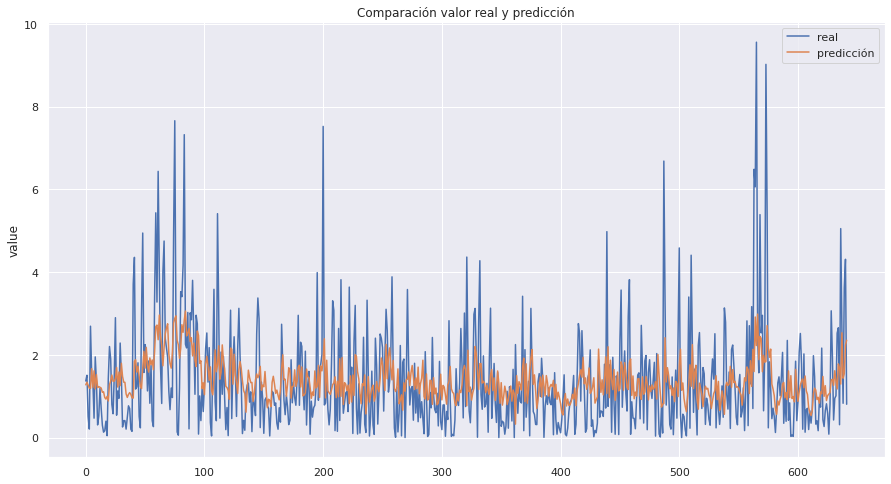

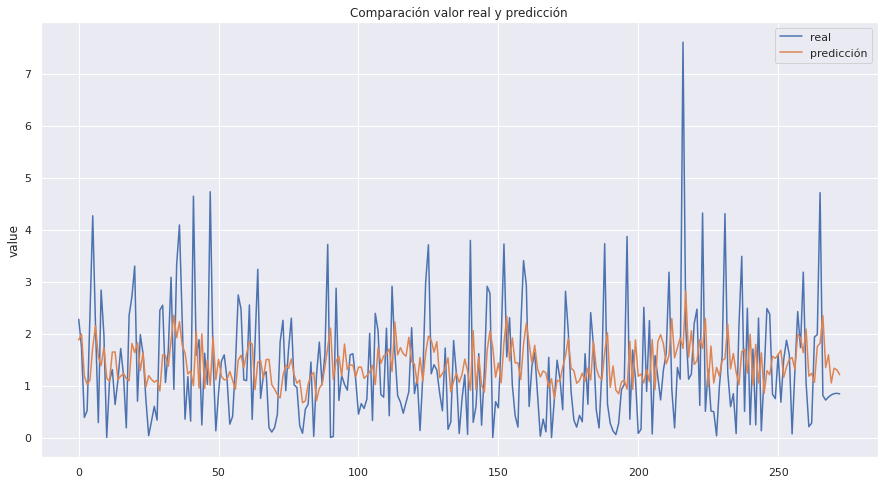

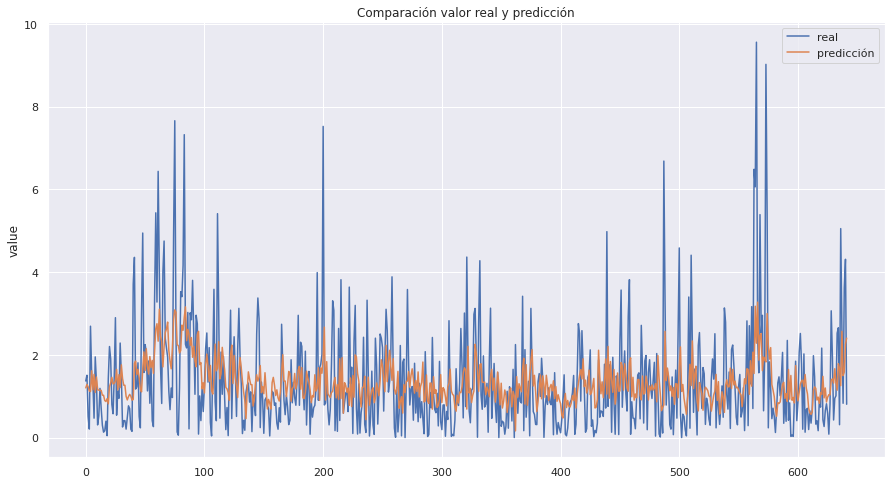

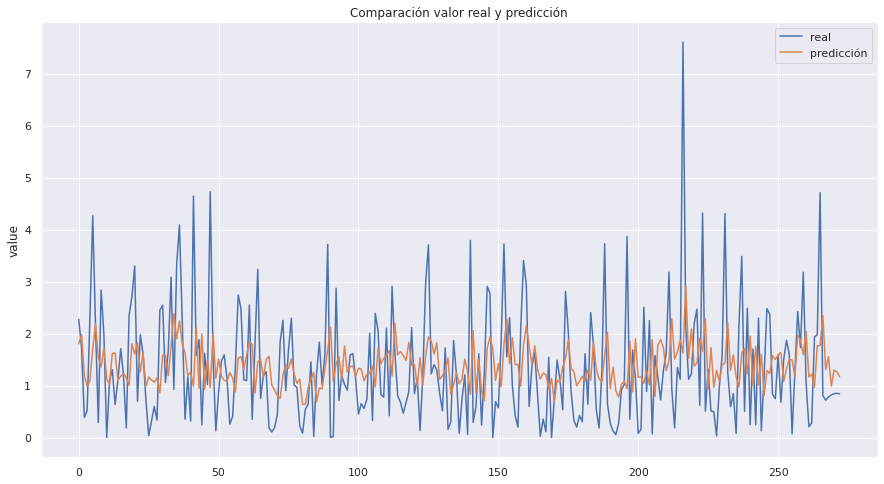

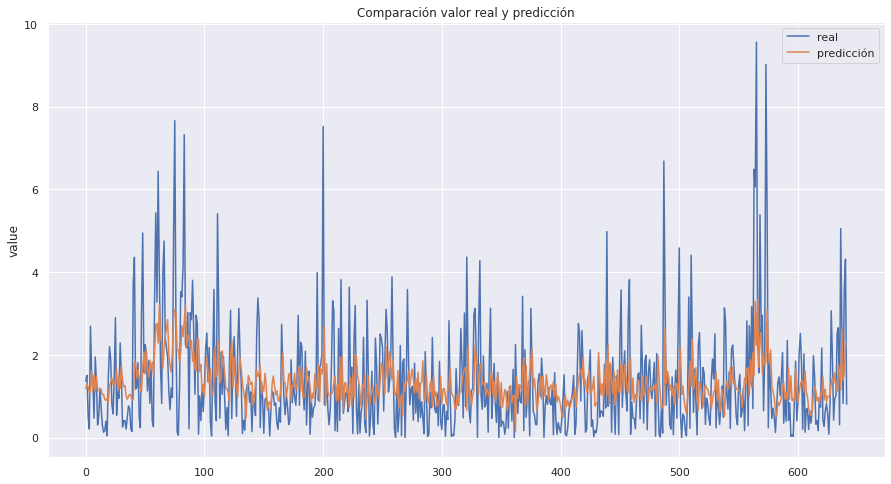

...

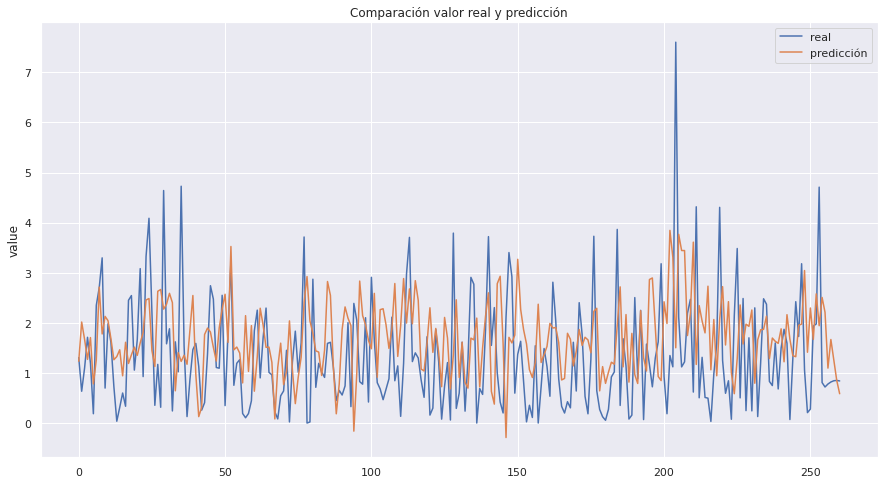

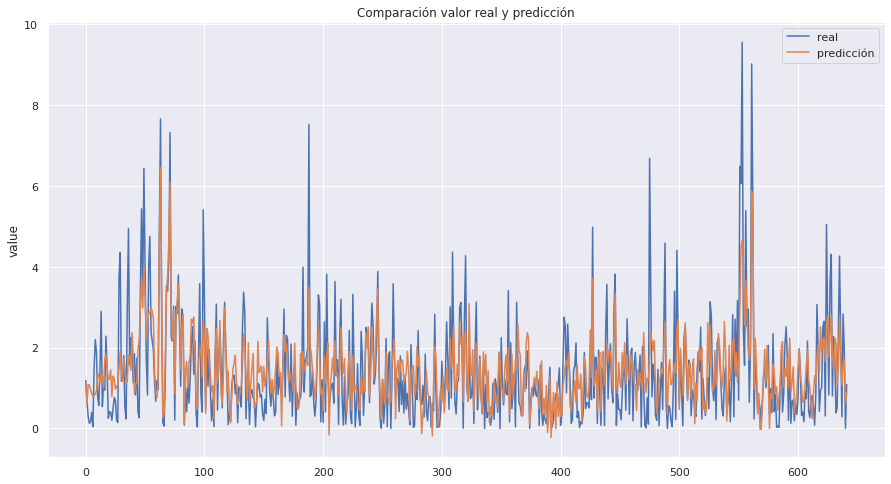

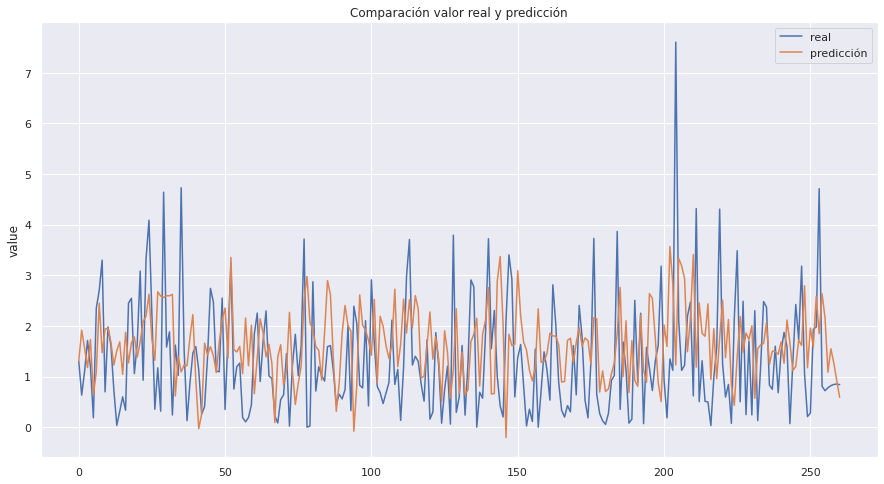

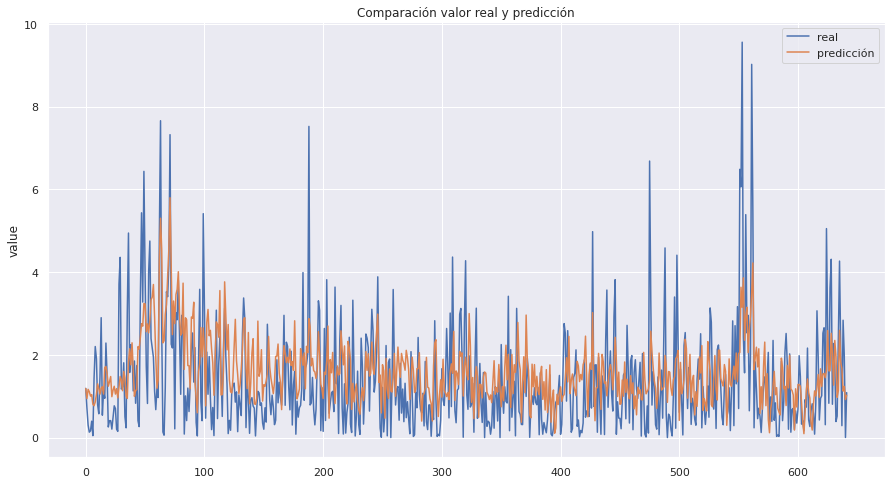

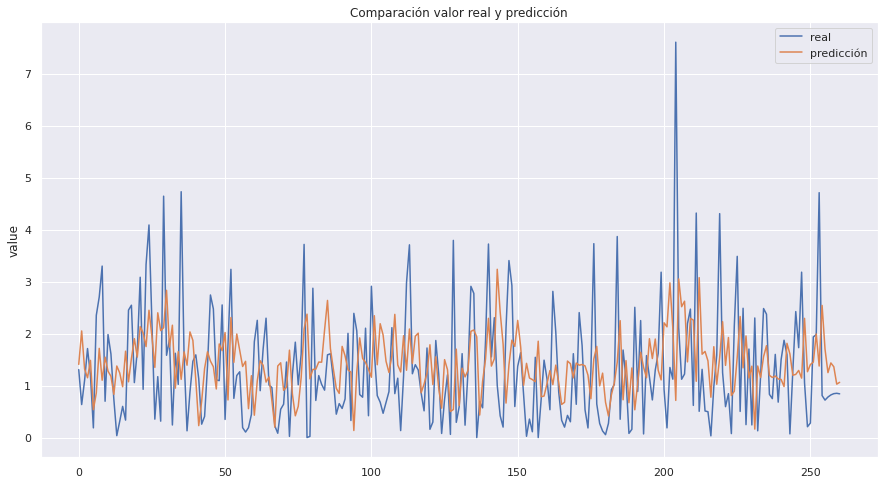

In [11]:
lags=[3,5,7,8,10,15]
n_estimators=[i for i in range(10,100,10)]
n_estimators.extend([200,300,500,2000])
results_models={i:{} for i in lags}
for lg in lags:
    for est in n_estimators:
        results_models[lg][est]=Model(df_data.copy(),df_label.copy(),lg,est)